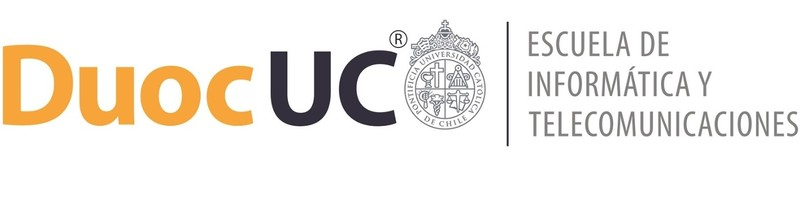

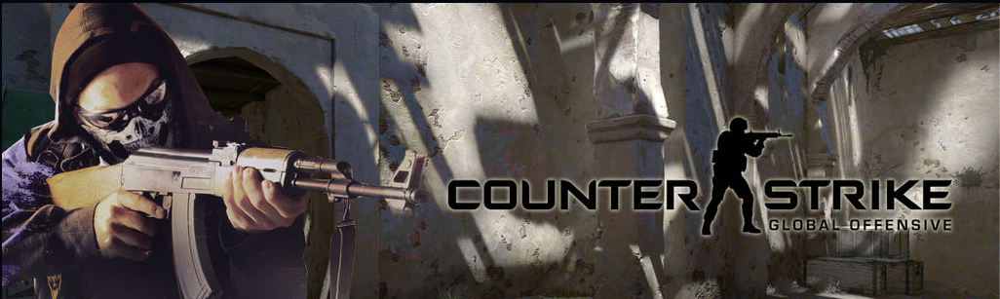

# Informe Técnico - Examen Transversal: Caso Counter Strike


Integrantes:
*Felipe leon
*Bastian ampuero
*GIANLUCA DE SINIS TUDOR

Docente: ITALO ANDRES BONET GARRIDO    

Sección: MLY0100 -003D

# Caso Fundamentos de Machine Learning

CONTEXTO CASO

Valve, los ha contactado como equipo de análisis de datos y modelado de Machine Learning para analizar y realizar modelos predictivos sobre los datos.

En cada partida de Counter Strike: GO dos equipos de 5 jugadores (denominados terroristas y contra-terroristas) se enfrentan.


El objetivo del equipo terrorista es plantar una bomba con timer de 45 segundos en uno de dos sitios específicos dentro de un mapa. Por otro lado, el objetivo del equipo contra-terrorista es evitar que la bomba sea plantada o desactivarla antes de que esta explote cuando ya ha sido plantada. Los datos a utilizar corresponden a sobre 7000 partidas del juego (con un máximo de 10 jugadores c/u)  


Los datos han sido extraídos de replays, los cuales son archivos propietarios con la información de cada una de las acciones realizadas por cada jugador dentro de una partida. Los replays han sido extraídos de la red utilizando un scrapper y pre-procesados utilizando un script.  



En este caso, la data corresponde a un archivo CSV con 79.157 filas, cada una correspondiente a un jugador dentro de una partida. El archivo contiene 29 columnas correspondientes a variables que describen las acciones del jugador dentro del juego.


$$
\begin{aligned}
&\begin{array}{cccc}
\hline \hline \text { Dato } & \text { Descripción } \\
\hline Map & \text {Nombre  del Mapa donde se jugó la partida}  \\
\hline \text{ Team} & \text { Nombre de equipo al que pertenece el jugador} \\
\hline \text{ InternalTeamId} & \text { Identificador del equipo al que pertenece el jugador.} \\
\hline \text{ MatchId} & \text { Identificador de la partida.} \\
\hline \text{ RoundId} & \text { Identificador de la ronda (los equipos se enfrentan en rondas de 5 partidas seguidas)} \\
\hline \text{ MatchWinner} & \text { Indica si el jugador ganó o no la partida.} \\
\hline \text{ RoundWinner} & \text { Indica si el jugador ganó o no la ronda analizada.} \\
\hline \text{ Survived} & \text { Indica si el jugador sobrevivió o no a la partida (sobrevivir no es sinónimo de ganar).} \\
\hline \text{ AbnormalMatch} & \text { Indica si la partida del jugador tuvo un error por conexión de red} \\
\hline \text{ TimeAlive} & \text { Indica el tiempo en segundos que el jugador estuvo vivo durante el juego} \\
\hline \text{ TravelledDistance} & \text { Distancia viajada por el jugador durante la partida.} \\
\hline \text{ RLethalGrenadesThrown/RNonLethalGrenadesThrown} & \text { Cantidad de granadas lanzadas, categorizadas en letales y no-letales.} \\
\hline \text{ PrimaryXXXX} & \text { Porcentaje de uso arma clasificada como primaria. Categorizada en AssaultRifle, SniperRifle, SMG, Heavy y Pistol.} \\
\hline \text{ [Match|Round] Assists} & \text { Cantidad de asistencias efectuadas por el jugador durante la partida o la ronda.} \\
\hline \text{ [Match|Round] Kills} & \text { Cantidad de kills efectuados por el jugador durante la partida o la ronda.} \\
\hline \text{ [Match|Round] FlankKills} & \text { Cantidad de kills efectuados por el jugador sin que la víctima lo viese durante la partida o la ronda.} \\
\hline \text{ [Match|Round] HeadShots} & \text { Cantidad de kills efectuados por el jugador a través de un tiro en la cabeza durante la partida o la ronda.} \\
\hline \text{ RoundStartingEquipmentValue} & \text { Valor del equipamiento llevado por el jugador al inicio de la ronda.} \\
\hline \text{ TeamStartingEquipmentValue} & \text { Valor promedio del equipamiento llevado por el equipo del jugador al inicio de la ronda.} \\
\end{array}
\end{aligned}
$$



---



## Fase 1: Business Understanding

In [ ]:
# Insertar cuantos bloques de código y markdown consideren necesarios
# Se recomienda investigar sobre el contexto de negocio, sobre los datos, uso de
# los campos en estadísticas de juegos, ver en qué se relacionan los contenidos
# revisados en la asignatura con lo planteado como caso de estudio.
# Plantear hipótesis del negocio posibles para objetivos de tareas de regresión y de clasificaciónsss

#  Entendimiento del Negocio (CS:GO)

**Objetivo**:  
Predecir el resultado de rondas *RoundWinner* para balancear el juego, usando datos de 7,000 partidas.

**Variables clave**:  
- *RoundKills* (kills por ronda)  
- *RoundHeadshots* (precisión)  
- *Map* (mapa usado)  
- *Team* (Terrorista/CT)  

**Hipótesis**:  
1. Más kills = mas probabilidad de ganar
  Esta hipótesis parte de una observación simple pero poderosa: en un juego competitivo eliminar al oponente reduce sus posibilidades de completar objetivos y por lo tanto, favorece directamente el control del mapa y la victoria. No se trata solo de matar más, sino de hacerlo en momentos clave como retomar un site o defenderlo con éxito.
2. Mapas como *de_inferno* favorecen a CT  
  A partir de la experiencia en partidas y del análisis de múltiples encuentros he notado que ciertos mapas están diseñados de forma que los CTs tienen más control de espacios clave o mejores ángulos defensivos lo que se traduce en una ventaja táctica sobre todo cuando el equipo coordina bien y mantiene la economía en orden.
3. Equipamiento caro mejora win rate
  Esta hipótesis se basa en la relación directa entre recursos y desempeño. Si un equipo entra a la ronda con rifles chalecos granadas y kits tiene una clara ventaja sobre uno con pistolas o armas económicas. En juegos de este tipo, la economía es un factor tan importante como la puntería y un buen equipamiento muchas veces marca la diferencia entre perder un duelo o ganarlo limpiamente.

**Métricas de éxito**:  
- **Precisión**: Que ojala el modelo tenga un acierto >70% de las predicciones  
- **Balance**: Que ambos equipos ganen entre 45%-55% de las rondas (que no este tan desbalanceado)  
- **Correlación**: Que kills y headshots tengan relación clara con la victoria para poder tener una buena corrrelacion




In [ ]:
import pandas as pd
import numpy as np
import seaborn as sb
import seaborn as sns
import matplotlib.pyplot as plt

pd.set_option('future.no_silent_downcasting', True)

In [ ]:
# ** Leer el archivo ET_demo_round_traces_2022.csv
from google.colab import files
uploaded = files.upload()
for fn in uploaded.keys():
    name=fn
df = pd.read_csv(name, sep=";")

Saving Anexo ET_demo_round_traces_2022.csv to Anexo ET_demo_round_traces_2022.csv


/tmp/ipython-input-2-174054996.py:6: DtypeWarning: Columns (6,7) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(name, sep=";")


---

## Fase 2: Data Understanding

In [ ]:
# Insertar cuantos bloques de código consideren necesarios
# Se recomienda obtener estadísticos descriptivos para apoyar hipótesis inferenciales.
# Reconocer la naturaleza de los datos y como tratarlos en etapas posteriores y dar ideas de como se podría transformar.
# Identificar MissingValues, outliers, medidas de posición, medidas de dispersión etc.

**Cantidad de filas y columnas**

In [ ]:
df.shape

(79157, 30)



---



**Overview de los datos**

In [ ]:
df.head()

,Unnamed: 0,Map,Team,InternalTeamId,MatchId,RoundId,RoundWinner,MatchWinner,Survived,AbnormalMatch,...,RoundKills,RoundAssists,RoundHeadshots,RoundFlankKills,RoundStartingEquipmentValue,TeamStartingEquipmentValue,MatchKills,MatchFlankKills,MatchAssists,MatchHeadshots
0,600,de_inferno,Terrorist,1,4,1,False,True,False,False,...,0,0,0,0,750,4400,0,0,0,0
1,601,de_inferno,Terrorist,1,4,1,False,True,False,False,...,0,0,0,0,800,4400,0,0,0,0
2,602,de_inferno,Terrorist,1,4,1,False,True,False,False,...,0,0,0,0,1000,4400,0,0,0,0
3,603,de_inferno,Terrorist,1,4,1,False,True,False,False,...,0,0,0,0,850,4400,0,0,0,0
4,604,de_inferno,Terrorist,1,4,1,False,True,True,False,...,0,0,0,0,1000,4400,0,0,0,0




---



**Tipos de datos**

In [ ]:
print(df.dtypes)

Unnamed: 0                       int64
Map                             object
Team                            object
InternalTeamId                   int64
MatchId                          int64
RoundId                          int64
RoundWinner                     object
MatchWinner                     object
Survived                          bool
AbnormalMatch                     bool
TimeAlive                       object
TravelledDistance               object
RLethalGrenadesThrown            int64
RNonLethalGrenadesThrown         int64
PrimaryAssaultRifle            float64
PrimarySniperRifle             float64
PrimaryHeavy                   float64
PrimarySMG                     float64
PrimaryPistol                    int64
FirstKillTime                   object
RoundKills                       int64
RoundAssists                     int64
RoundHeadshots                   int64
RoundFlankKills                  int64
RoundStartingEquipmentValue      int64
TeamStartingEquipmentValu



---



Podemos idenfiticar que las columnas RoundWinner y MatchWinner son objects, pero estos deberían ser booleanos

In [ ]:
df.RoundWinner.unique()

array(['False', 'True', 'False4', True, False], dtype=object)

Acá podemos ver que hay un valor erróneo, "False4"

In [ ]:
df.MatchWinner.unique()

array([True, False, nan], dtype=object)

Y acá vemos que hay un valor nulo



---



**Identificando datos nulos**

In [ ]:
df.isna().sum()

,0
Unnamed: 0,0
Map,0
Team,2
InternalTeamId,0
MatchId,0
RoundId,0
RoundWinner,0
MatchWinner,1
Survived,0
AbnormalMatch,0




---



**Resumen de los datos**

In [ ]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Unnamed: 0,79157.0,60570.193640,36436.598386,600.0,30830.0,56720.0,90639.0,123779.0
InternalTeamId,79157.0,1.500006,0.500003,1.0,1.0,2.0,2.0,2.0
MatchId,79157.0,250.525033,149.557804,4.0,128.0,236.0,373.0,511.0
RoundId,79157.0,12.765517,7.432837,1.0,6.0,12.0,19.0,36.0
RLethalGrenadesThrown,79157.0,0.498667,0.597985,0.0,0.0,0.0,1.0,4.0
RNonLethalGrenadesThrown,79157.0,1.258057,1.184909,0.0,0.0,1.0,2.0,6.0
PrimaryAssaultRifle,79157.0,0.675363,0.464125,0.0,0.0,1.0,1.0,1.0
PrimarySniperRifle,79157.0,0.089840,0.279797,0.0,0.0,0.0,0.0,1.0
PrimaryHeavy,79157.0,0.005964,0.075497,0.0,0.0,0.0,0.0,1.0
PrimarySMG,79157.0,0.007046,0.082453,0.0,0.0,0.0,0.0,1.0




---



**Overview de TravelledDistance**

In [ ]:
df.TravelledDistance.cummax()

,TravelledDistance
0,10.083.140.737.457.000
1,60.960.883.184.688.400
2,60.960.883.184.688.400
3,8.963.473.313.229.970
4,8.963.473.313.229.970
...,...
79152,999.995.831.977.239
79153,999.995.831.977.239
79154,999.995.831.977.239
79155,999.995.831.977.239


Podemos identificar que los valores que hay en TravelledDistance están fuera de cualquier valor posible e interpretable en el juego, y al ser números tan grandes quedan con tipo object.



---



**Overview de TimeAlive**

In [ ]:
df.TimeAlive.cummax()

,TimeAlive
0,51.120.248.995.704.500
1,51.120.248.995.704.500
2,51.120.248.995.704.500
3,51.120.248.995.704.500
4,51.120.248.995.704.500
...,...
79152,999.389.586.860.696
79153,999.389.586.860.696
79154,999.389.586.860.696
79155,999.389.586.860.696


Ocurre lo mismo que en TravelledDistance, estos datos no toman ningún valor posible dentro del juego y no se pueden interpretar, además de también ser object.



---



**Overview de FirstTimeKill**
máximo acumulativo de una serie o columna de un DataFrame.

In [ ]:
df.FirstKillTime.cummax()

,FirstKillTime
0,0.0
1,0.0
2,0.0
3,0.0
4,0.0
...,...
79152,999.746
79153,999.746
79154,999.746
79155,999.746




---



In [ ]:
filtered = df[df['PrimaryAssaultRifle'] != 0]
filtered = filtered[filtered['PrimaryAssaultRifle'] != 1]

print(filtered['PrimaryAssaultRifle'].max())
print(filtered['PrimaryAssaultRifle'].min())

0.9994982438534874
0.0005633802816901


Ciertos valores de los porcentajes de uso de armas (Assault Rifle, Sniper Rifle, etc) tienen muchísima exactitud en los decimales, lo cual si se mide en tiempo la exactitud sería demasiada y podría hacer que sea menos eficiente trabajar con estos valores.



---



**Ver qué valores únicos puede tomar AbnormalMatch**

In [ ]:
df.AbnormalMatch.unique()

array([False])

Podemos identificar que todos los valores de AbnormalMatch son false.



---



In [ ]:
df.Survived.unique()

array([False,  True])

**Diagramas de caja de las columnas**

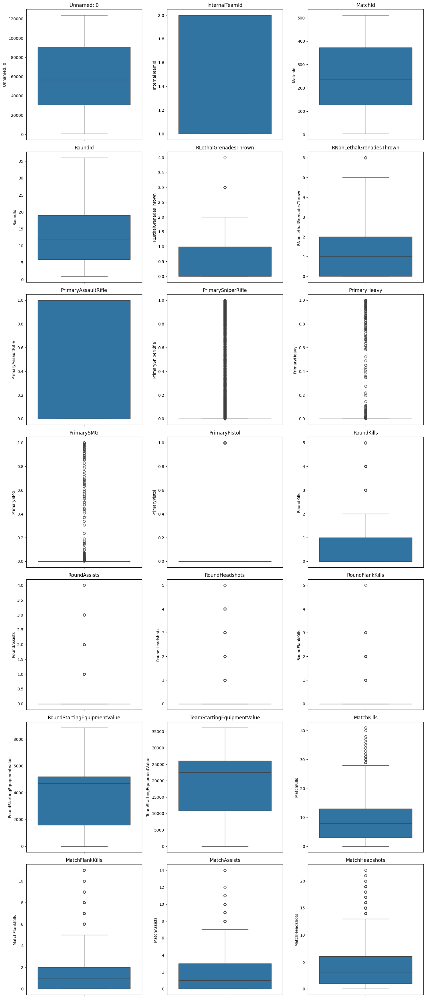

In [ ]:
num_cols = df.select_dtypes(include=np.number).columns
num_plots = len(num_cols)
cols = 3
rows = (num_plots + cols - 1) // cols

fig, axes = plt.subplots(rows, cols, figsize=(15, 5*rows))

for i, col in enumerate(num_cols):
  row = i // cols
  col_idx = i % cols
  ax = axes[row, col_idx] if rows > 1 else axes[col_idx]

  sns.boxplot(y=df[col], ax=ax)
  ax.set_title(col)
  ax.set_xlabel('')

for i in range(num_plots, rows * cols):
    row = i // cols
    col_idx = i % cols
    fig.delaxes(axes[row, col_idx] if rows > 1 else axes[col_idx])

plt.tight_layout()
plt.show()

**

<Axes: >

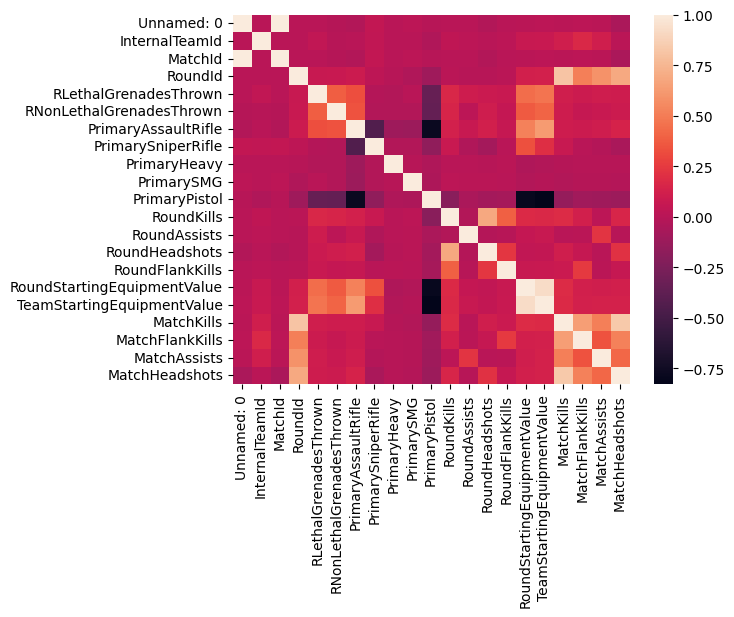

In [ ]:
numeric_data = df.select_dtypes(include=[np.number])

corr = numeric_data.corr()
sns.heatmap(corr)

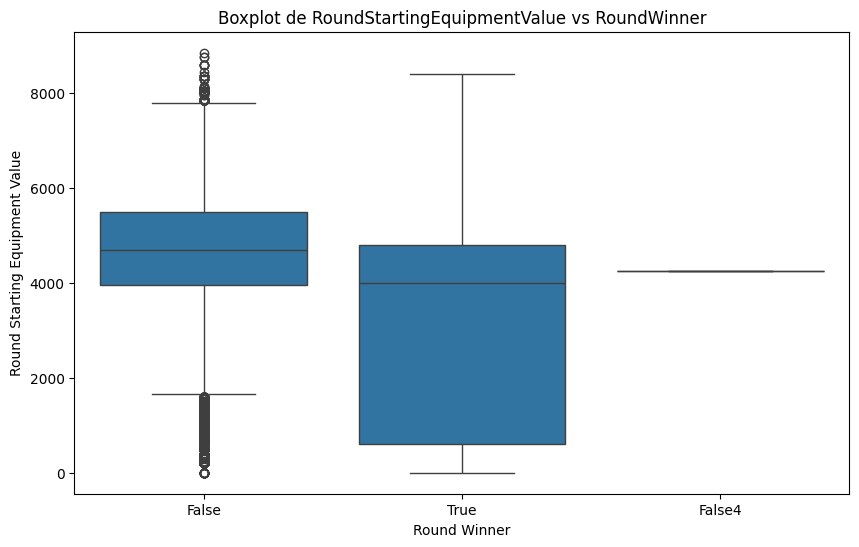

In [ ]:
plt.figure(figsize=(10, 6))
sns.boxplot(x='RoundWinner', y='RoundStartingEquipmentValue', data=df)
plt.title('Boxplot de RoundStartingEquipmentValue vs RoundWinner')
plt.xlabel('Round Winner')
plt.ylabel('Round Starting Equipment Value')
plt.show()

Tener más equipamiento inicial no garantiza ganar la ronda, ambos grupos muestran mucha variabilidad y valores similares en su mediana.

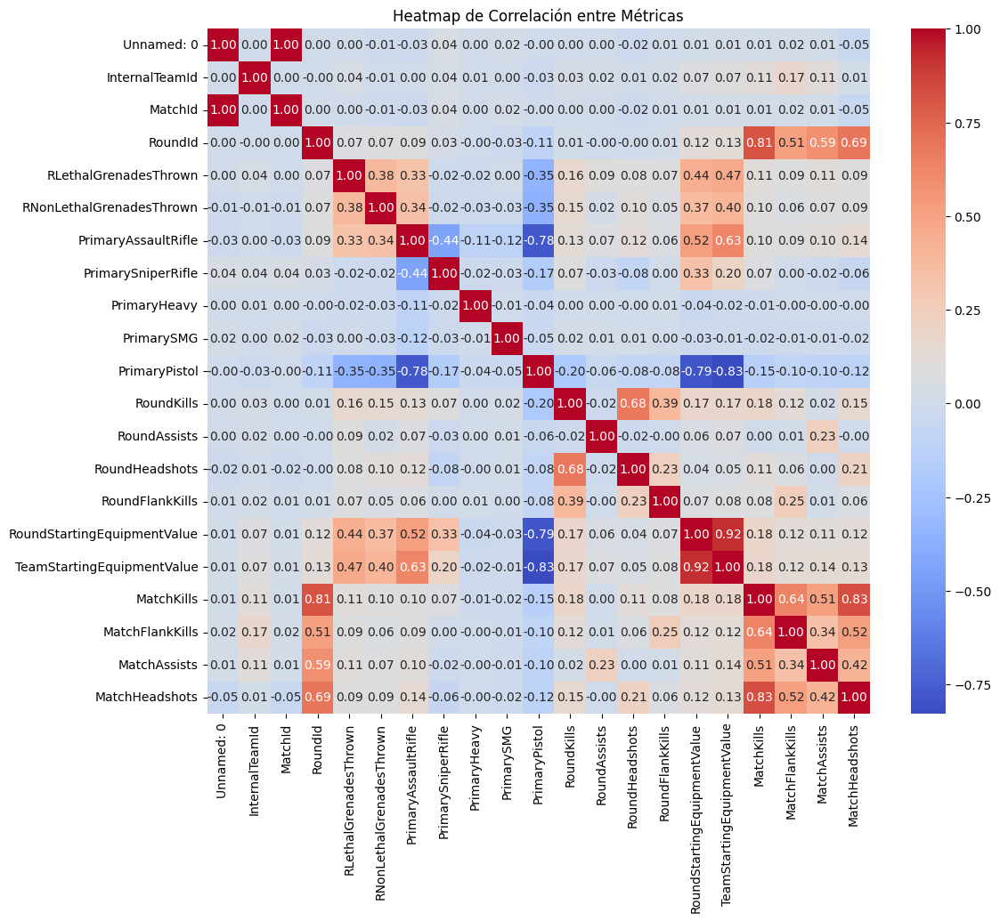

In [ ]:
numeric_data = df.select_dtypes(include=[np.number])
corr = numeric_data.corr()
plt.figure(figsize=(12, 10))
sns.heatmap(corr, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Heatmap de Correlación entre Métricas')
plt.show()

Lo que se busca es visualizar que estadisticas de las variables se relaciona entre si. Cuando son rojo  o azul intenso indican una fuerte relacion. Mas que nada nos ayuda a entender los patrones de juego y que factores influyen en los rendimiento de los players.

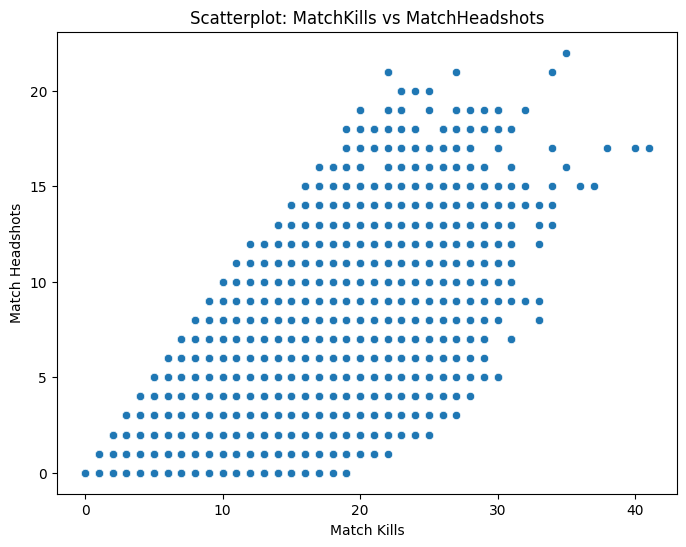

In [ ]:
plt.figure(figsize=(8, 6))
sns.scatterplot(x='MatchKills', y='MatchHeadshots', data=df)
plt.title('Scatterplot: MatchKills vs MatchHeadshots')
plt.xlabel('Match Kills')
plt.ylabel('Match Headshots')
plt.show()

Se puede observar una tendencia positiva, ya que indica que generalmente a mayor numero de eliminaciones totales. Obviamente mayor cantidad de disparos a la cabeza, aun que la relacion no es perfectamente lineal.

## Fase 3: Data Preparation

In [ ]:
# Insertar cuantos bloques de código consideren necesarios
# Se recomienda considerar todas las transformaciones necesarias para obtener la data lo más limpia posible.
# Realizar tratamiento a todos los datos que consideren necesarios.

**Eliminado de variables irrelevantes**

In [ ]:
#Drop de variables que no necesitamos. TravelledDistance no es relevante y TimeAlive y FirstKillTime. no hay manera de representar ya que son billones/trillones
columns_to_drop = ['Unnamed: 0', 'MatchId', 'RoundId', 'InternalTeamId','TravelledDistance','TimeAlive','FirstKillTime','AbnormalMatch']
existing_columns = [col for col in columns_to_drop if col in df.columns]

df.drop(columns=existing_columns, inplace=True)

**Manejo de nulos**

In [ ]:
df.dropna(subset=['Team', 'MatchWinner'], inplace=True)

**Mapas**

In [ ]:
print(list(df['Map'].unique()))

['de_inferno', 'de_nuke', 'de_mirage', 'de_dust2']


**Cambiar mapas a números**


In [ ]:
df['Map'] = df['Map'].replace({"de_inferno":1, "de_nuke":2, "de_mirage":3, "de_dust2":4})

**Cambiar equipos a números**

In [ ]:
df['Team'] = df['Team'].replace({"Terrorist":0, "CounterTerrorist":1})

**Cambiamos survived y matchwinner**



In [ ]:
# Conversión de valores booleanos a binarios (0 y 1)
df.MatchWinner.replace({"True": 1, "False": 0}, inplace=True)

df.Survived.replace({"True": 1, "False": 0}, inplace=True)


<ipython-input-20-b39495bac3e3>:2: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df.MatchWinner.replace({"True": 1, "False": 0}, inplace=True)
<ipython-input-20-b39495bac3e3>:4: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=Tru

**Redondear porcentajes de las armas al 5to decimal**

In [ ]:
columns_to_round = ['PrimaryAssaultRifle', 'PrimarySniperRifle', 'PrimaryHeavy', 'PrimarySMG', 'PrimaryPistol']
for column in columns_to_round:
    if column in df.columns:
        df[column] = df[column].round(5)


**Modificacion de roundwiner a numerico**

In [ ]:
df = df[df['RoundWinner'].isin(['True', 'False'])]
df.RoundWinner.replace({"True": 1, "False": 0}, inplace=True)


<ipython-input-22-c557df9a46a4>:2: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df.RoundWinner.replace({"True": 1, "False": 0}, inplace=True)
<ipython-input-22-c557df9a46a4>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.RoundWinner.replace({"True": 1, "False": 0}, inplace=True)


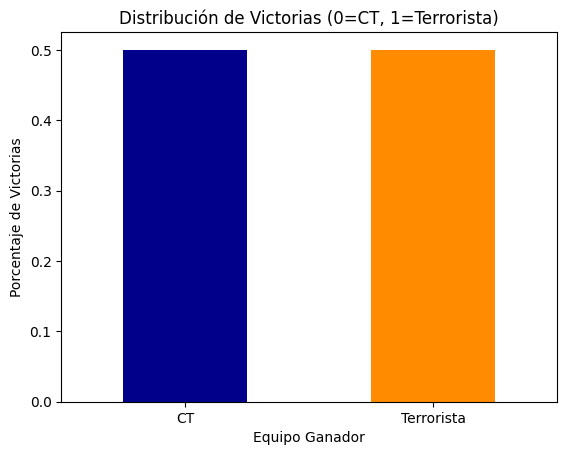

In [ ]:
# Distribución de RoundWinner (ahora con 0/1)
df['RoundWinner'].value_counts(normalize=True).plot(kind='bar', color=['darkblue', 'darkorange'])
plt.title('Distribución de Victorias (0=CT, 1=Terrorista)')
plt.xlabel('Equipo Ganador')
plt.ylabel('Porcentaje de Victorias')
plt.xticks([0, 1], ['CT', 'Terrorista'], rotation=0)
plt.show()

El grafico es ct=0 y terrorista(1), tiene una distribución casi equilibrada de victoria de 50% cada uno indicando un balance competitivo en los datos.

**Estadistica clave para saber RoundKills y RoundHeadshots**

In [ ]:
print("\nEstadísticas clave:")
print(df[['RoundKills', 'RoundHeadshots']].describe())


Estadísticas clave:
         RoundKills  RoundHeadshots
count  32765.000000    32765.000000
mean       0.667938        0.313383
std        0.879284        0.592711
min        0.000000        0.000000
25%        0.000000        0.000000
50%        0.000000        0.000000
75%        1.000000        1.000000
max        5.000000        5.000000


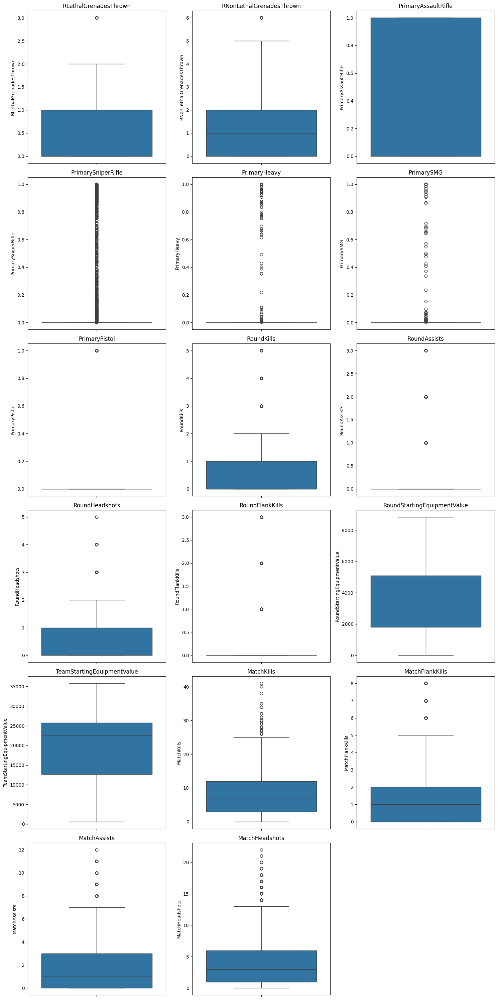

In [ ]:
num_cols = df.select_dtypes(include=np.number).columns
num_plots = len(num_cols)
cols = 3
rows = (num_plots + cols - 1) // cols

fig, axes = plt.subplots(rows, cols, figsize=(15, 5*rows))

for i, col in enumerate(num_cols):
  row = i // cols
  col_idx = i % cols
  ax = axes[row, col_idx] if rows > 1 else axes[col_idx]

  sns.boxplot(y=df[col], ax=ax)
  ax.set_title(col)
  ax.set_xlabel('')

for i in range(num_plots, rows * cols):
    row = i // cols
    col_idx = i % cols
    fig.delaxes(axes[row, col_idx] if rows > 1 else axes[col_idx])

plt.tight_layout()
plt.show()

## Fase 4: Modeling

### Modelos de Regresión

#### Hipotesis #1


##### Regresión Lineal

Y - variable objetivo:

MatchKills variable dependiente y

X-predictoras:

MatchAssists

MatchHeadshots

TeamStartingEquipmentValue

En este bloque realizo un modelo de regresión para predecir la cantidad de kills en una partida (MatchKills) en base a distintas variables relacionadas al rendimiento del jugador. Se seleccionan las variables predictoras (X), se divide el set de datos en entrenamiento y prueba, y se entrena un modelo de regresión lineal. Finalmente se evalúa el modelo con métricas como R² y RMSE.

In [ ]:
from sklearn.model_selection import cross_val_score, train_test_split
from sklearn.linear_model import LinearRegression
import numpy as np

split_ratios = [0.1, 0.15, 0.2, 0.25, 0.3]
scores = []

X = df[['MatchAssists', 'MatchHeadshots']]
y = df['MatchKills']

for ratio in split_ratios:
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=ratio, random_state=42)

    # Linear Regression (original)
    lr_model = LinearRegression()
    lr_cv_scores = cross_val_score(lr_model, X_train, y_train, cv=5, scoring='r2')

    scores.append({
        'split_ratio': ratio,
        'lr_mean_r2': lr_cv_scores.mean()
    })

best_lr = max(scores, key=lambda x: x['lr_mean_r2'])

print(f"Split: {best_lr['split_ratio']}, R2: {best_lr['lr_mean_r2']:.4f}")

Split: 0.1, R2: 0.7471


Calculamos el mejor split y en este caso nos da 0.1

R²: 0.7542540598312171
RMSE: 3.0388698023842884


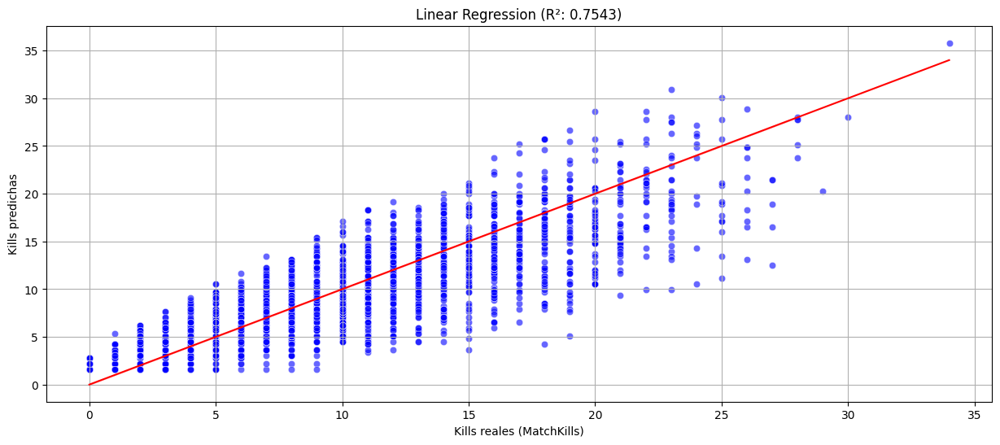

In [ ]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score, mean_squared_error
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

X = df[['MatchAssists', 'MatchHeadshots']]
y = df['MatchKills']

X = X.fillna(0)
y = y.fillna(0)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=42)


lr_model = LinearRegression()
lr_model.fit(X_train, y_train)
lr_pred = lr_model.predict(X_test)

rlin_h1_r2 = r2_score(y_test, lr_pred)
rlin_h1_rmse = np.sqrt(mean_squared_error(y_test, lr_pred))

print("R²:", rlin_h1_r2)
print("RMSE:", rlin_h1_rmse)

rlin_h1 = plt

fig, (ax1) = rlin_h1.subplots(1, figsize=(15, 6))

sns.scatterplot(x=y_test, y=lr_pred, alpha=0.6, color='blue', ax=ax1)
sns.lineplot(x=y_test, y=y_test, color='red', ax=ax1)
ax1.set_xlabel('Kills reales (MatchKills)')
ax1.set_ylabel('Kills predichas')
ax1.set_title(f'Linear Regression (R²: {rlin_h1_r2:.4f})')
ax1.grid(True)

rlin_h1.show()

R² = 0.754 El modelo explica el ~75.4% de la variabilidad en la cantidad de kills de la partida a partir de las variables seleccionadas. Esto es un buen nivel de ajuste para un modelo simple.


Cuanto más cerca estén los puntos de la línea roja, mejor está funcionando el modelo.

##### Support Vector Regression

Cálculo de hiperparámetros

In [ ]:
from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.svm import SVR
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import r2_score, mean_squared_error
import numpy as np

variables = ['MatchAssists', 'MatchHeadshots']
X = df[variables].fillna(0)
y = df['MatchKills'].fillna(0).astype(int)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

param_grid = {
    'kernel': ['linear'],
    'C': [1, 10],
    'gamma': ['scale']
}

svm = SVR()

grid_search = GridSearchCV(
    svm,
    param_grid,
    cv=2,
    scoring='neg_mean_squared_error',
    n_jobs=-1,
)

grid_search.fit(X_train_scaled, y_train)

print("Mejores parámetros:", grid_search.best_params_)
print("Mejor puntaje CV:", grid_search.best_score_)

svm_pred = grid_search.predict(X_test_scaled)
svr_h1_r2 = r2_score(y_test, svm_pred)
svr_h1_rmse = np.sqrt(mean_squared_error(y_test, svm_pred))

print(f"R² = {svr_h1_r2:.4f}, RMSE = {svr_h1_rmse:.4f}")

Mejores parámetros: {'C': 10, 'gamma': 'scale', 'kernel': 'linear'}
Mejor puntaje CV: -9.701087179348999
R² = 0.7446, RMSE = 3.0706


Cálculo de split

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVR
from sklearn.metrics import r2_score

split_ratios = [0.1, 0.2, 0.3]
svm_scores = []

variables = ['MatchAssists', 'MatchHeadshots']
X = df[variables].fillna(0)
y = df['MatchKills'].fillna(0)

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
y_scaled = scaler.fit_transform(y.values.reshape(-1, 1)).flatten()

for ratio in split_ratios:
    X_train, X_test, y_train, y_test = train_test_split(X_scaled, y_scaled, test_size=ratio, random_state=42)

    svr = SVR(kernel='linear', C=10, epsilon=0.1, gamma='scale')
    svr.fit(X_train, y_train)
    svm_pred = svr.predict(X_test)
    svm_r2 = r2_score(y_test, svm_pred)

    svm_scores.append({
        'split_ratio': ratio,
        'r2': svm_r2
    })


best_svm_split = max(svm_scores, key=lambda x: x['r2'])

print(f"Mejor split: {best_svm_split['split_ratio']}")
print(f"R2: {best_svm_split['r2']:.4f}")

Mejor split: 0.2
R2: 0.7446


In [ ]:
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVR
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score

variables = ['MatchAssists', 'MatchHeadshots']
X = df[variables].fillna(0)
y = df['MatchKills'].fillna(0)

# Escalado para SVM
scaler_X = StandardScaler()
X_scaled = scaler_X.fit_transform(X)
scaler_y = StandardScaler()
y_scaled = scaler_y.fit_transform(y.values.reshape(-1, 1)).flatten()

# Dividir datos en entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y_scaled, test_size=0.2, random_state=42)

# Entrenar modelo SVR
svr = SVR(kernel='linear', C=10, epsilon=0.1, gamma='scale')
svr.fit(X_train, y_train)
svr_pred_test = svr.predict(X_test)
svr_h1_r2 = r2_score(y_test, svr_pred_test)

print(f"SVM R2: {svr_h1_r2:.4f}")

# Predecir resultados completos
svr_pred_all = svr.predict(X_scaled)

plot_df = pd.DataFrame({
    'MatchAssists': X_scaled[:, 0],
    'MatchHeadshots': X_scaled[:, 1],
    'Kills_Reales': y,
    'SVR_Prediccion': svr_pred_all,
})

# Changed to a 2D scatter plot
svr_h1 = make_subplots(
    rows=1, cols=1,
    subplot_titles=[f'SVM (R²: {svr_h1_r2:.4f})']
)

# SVR plot (2D)
svr_h1.add_trace(
    go.Scatter(
        x=plot_df['MatchAssists'],
        y=plot_df['MatchHeadshots'],
        mode='markers',
        marker=dict(
            size=4,
            color=plot_df['SVR_Prediccion'],
            colorscale='Viridis',
            opacity=0.7,
            colorbar=dict(title='SVR Predicción (Scaled)')
        ),
        name='SVM'
    ),
    row=1, col=1
)

svr_h1.update_layout(
    xaxis_title="Match Assists (Scaled)",
    yaxis_title="Match Headshots (Scaled)",
    title_text=f'SVM Predictions vs. Features (R²: {svr_h1_r2:.4f})'
)

svr_h1.show()

SVM R2: 0.7446


La visualización 3D revela que los equipos ganadores (naranja) se concentran en valores altos de MatchAssists y MatchHeadshots, confirmando su influencia en el resultado. Sin embargo, el solapamiento con perdedores (azul) en zonas medias sugiere que estas variables son predictores parciales, necesitando complementarse con otros factores para mayor precisión. Conclusión: Las variables analizadas impactan el resultado, pero no son determinantes por sí solas.

##### Decision Tree Regressor


Cálculo de hiperparámetros y entrenamiento

Mejor split: {0.1}
Mejores parámetros RF: {'max_depth': 5, 'min_samples_leaf': 1, 'min_samples_split': 2, 'splitter': 'best'}
Mejor puntaje RF: 0.754661421165344
  MSE: 9.16
  R2: 0.7475


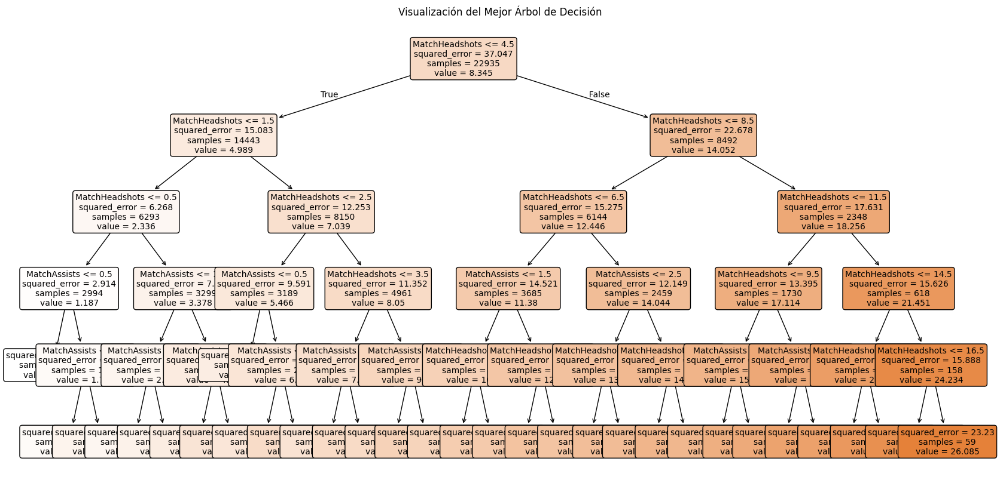

In [ ]:
from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import mean_squared_error, r2_score
import matplotlib.pyplot as plt
from sklearn.tree import plot_tree

X = df[['MatchAssists', 'MatchHeadshots']]
y = df['MatchKills']

dt_param_grid = {
    'max_depth': [3, 5],  # Reducido de [3,4] a [3,5] para mejor rango
    'min_samples_split': [2, 10],  # Reducido de [2,5,10] a [2,10]
    'min_samples_leaf': [1, 4],  # Reducido de [1,2,4] a [1,4]
    'splitter': ['best']  # Solo 'best' (más eficiente que 'random')
}

split_ratios = [0.1, 0.15, 0.2, 0.25, 0.3]
results = {}

# GridSearch para Random Forest
for split in split_ratios:
    X_train, X_test, y_train, y_test = train_test_split(
        X, y,
        test_size=split,
        random_state=11
    )

    tree = DecisionTreeRegressor(random_state=42)
    dt_grid_search = GridSearchCV(
        tree,
        dt_param_grid,
        cv=3,
        scoring='r2',
        n_jobs=-1
    )

    dt_grid_search.fit(X_train, y_train)

    best_tree = dt_grid_search.best_estimator_
    dt_pred = best_tree.predict(X_test)
    dt_r2 = r2_score(y_test, dt_pred)

    results[split] = dt_r2


best_split_ratio = max(results, key=results.get)
best_r2_score = results[best_split_ratio]

print("Mejor split:", {best_split_ratio})
print("Mejores parámetros RF:", dt_grid_search.best_params_)
print("Mejor puntaje RF:", dt_grid_search.best_score_)

# Decision Tree
best_tree = dt_grid_search.best_estimator_
dt_pred = best_tree.predict(X_test)
dt_h1_mse = mean_squared_error(y_test, dt_pred)
dt_h1_r2 = r2_score(y_test, dt_pred)

print(f'  MSE: {dt_h1_mse:.2f}')
print(f'  R2: {dt_h1_r2:.4f}')

dt_h1 = plt

dt_h1.figure(figsize=(20, 10))
plot_tree(
    best_tree,
    feature_names=X.columns.tolist(),
    filled=True,
    rounded=True,
    fontsize=10
)
dt_h1.title("Visualización del Mejor Árbol de Decisión")
dt_h1.show()

##### Random Forest Regressor

Cálculo de hiperparámetros, split y entrenamiento

Mejor split: {0.1}
Mejores parámetros RF: {'max_depth': None, 'min_samples_split': 2, 'n_estimators': 50}
Mejor puntaje RF: 0.7598906931663144
  MSE: 9.03
  R2: 0.7511


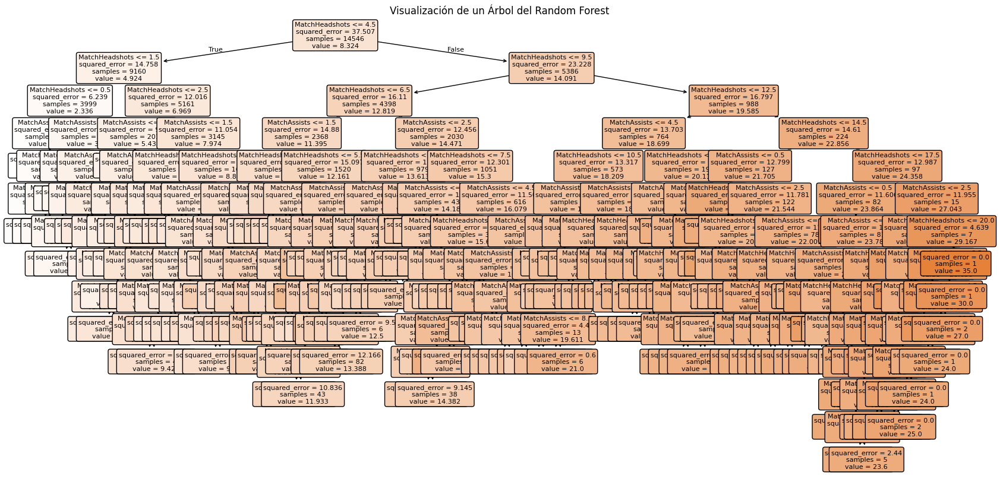

In [ ]:
from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score
import matplotlib.pyplot as plt
from sklearn.tree import plot_tree

X = df[['MatchAssists', 'MatchHeadshots']]
y = df['MatchKills']

rf_param_grid = {
    'n_estimators': [50, 100],
    'max_depth': [3, 5, None],
    'min_samples_split': [2, 10]
}

split_ratios = [0.1, 0.15, 0.2, 0.25, 0.3]
results = {}

# GridSearch para Random Forest
for split in split_ratios:
    X_train, X_test, y_train, y_test = train_test_split(
        X, y,
        test_size=split,
        random_state=11
    )

    rf = RandomForestRegressor(random_state=42)
    rf_grid_search = GridSearchCV(
        rf,
        rf_param_grid,
        cv=3,
        scoring='r2',
        n_jobs=-1
    )

    rf_grid_search.fit(X_train, y_train)

    best_rf = rf_grid_search.best_estimator_
    rf_pred = best_rf.predict(X_test)
    rf_r2 = r2_score(y_test, rf_pred)

    results[split] = rf_r2


best_split_ratio = max(results, key=results.get)
best_r2_score = results[best_split_ratio]

print("Mejor split:", {best_split_ratio})
print("Mejores parámetros RF:", rf_grid_search.best_params_)
print("Mejor puntaje RF:", rf_grid_search.best_score_)

# Random Forest
best_rf = rf_grid_search.best_estimator_
rf_pred = best_rf.predict(X_test)
rfr_h1_mse = mean_squared_error(y_test, rf_pred)
rfr_h1_r2 = r2_score(y_test, rf_pred)

print(f'  MSE: {rfr_h1_mse:.2f}')
print(f'  R2: {rfr_h1_r2:.4f}')

tree_to_plot = best_rf.estimators_[0]

rfr_h1 = plt

rfr_h1.figure(figsize=(20, 10))
plot_tree(
    tree_to_plot,
    feature_names=X.columns.tolist(),
    filled=True,
    rounded=True,
    fontsize=8
)
rfr_h1.title("Visualización de un Árbol del Random Forest")
rfr_h1.show()

##### KNN Regressor

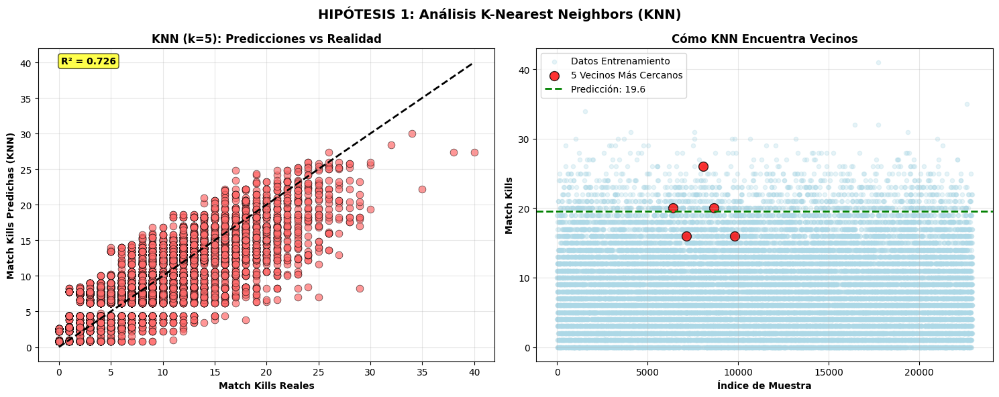

KNN (k=5) - R²: 0.726, MAE: 2.403


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.neighbors import KNeighborsRegressor
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score
import seaborn as sns

# Configurar variables (usar tus datos reales)
X = df[['MatchAssists', 'MatchHeadshots']]
y = df['MatchKills']
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Dividir datos
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.3, random_state=42)

# Modelo KNN
k = 5
knn = KNeighborsRegressor(n_neighbors=k)
knn.fit(X_train, y_train)
y_pred = knn.predict(X_test)

knn_r_h1 = plt

# Crear gráficos
fig, (ax1, ax2) = knn_r_h1.subplots(1, 2, figsize=(15, 6))
fig.suptitle('HIPÓTESIS 1: Análisis K-Nearest Neighbors (KNN)', fontsize=14, fontweight='bold')

# Gráfico 1: KNN Predicciones vs Reales
ax1.scatter(y_test, y_pred, alpha=0.7, color='#FF6B6B', s=60, edgecolors='black', linewidth=0.5)
ax1.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
ax1.set_xlabel('Match Kills Reales', fontweight='bold')
ax1.set_ylabel('Match Kills Predichas (KNN)', fontweight='bold')
ax1.set_title(f'KNN (k={k}): Predicciones vs Realidad', fontweight='bold')
ax1.grid(True, alpha=0.3)

# Mostrar R²
knn_r_h1_r2 = r2_score(y_test, y_pred)
ax1.text(0.05, 0.95, f'R² = {knn_r_h1_r2:.3f}', transform=ax1.transAxes,
         bbox=dict(boxstyle="round", facecolor="yellow", alpha=0.7), fontweight='bold')

# Gráfico 2: Visualización de vecinos cercanos
ax2.scatter(range(len(y_train)), y_train, alpha=0.3, color='lightblue', s=20, label='Datos Entrenamiento')

# Ejemplo de vecinos para un punto específico
test_idx = 10
test_point = X_test[test_idx].reshape(1, -1)
distances, indices = knn.kneighbors(test_point)
neighbors_y = y_train.iloc[indices[0]]

ax2.scatter(indices[0], neighbors_y, color='red', s=100, alpha=0.8,
           label=f'{k} Vecinos Más Cercanos', edgecolors='black', linewidth=1)
ax2.axhline(y=y_pred[test_idx], color='green', linestyle='--', linewidth=2,
           label=f'Predicción: {y_pred[test_idx]:.1f}')
ax2.set_xlabel('Índice de Muestra', fontweight='bold')
ax2.set_ylabel('Match Kills', fontweight='bold')
ax2.set_title('Cómo KNN Encuentra Vecinos', fontweight='bold')
ax2.legend()
ax2.grid(True, alpha=0.3)

knn_r_h1.tight_layout()
knn_r_h1.show()

# Métricas KNN
knn_r_h1_mae = np.mean(np.abs(y_test - y_pred))
print(f"KNN (k={k}) - R²: {knn_r_h1_r2:.3f}, MAE: {knn_r_h1_mae:.3f}")

#### Hipótesis #2





##### Regresión Lineal


**TeamStartingEquipmentValue**
Elegimos esta variable porque representa cuánto invierte el equipo en equipamiento al comenzar la ronda. En teoría, si un equipo parte con más recursos (mejores armas, armaduras, etc.), debería tener mayor capacidad de combate, lo cual se traduciría en más kills durante el transcurso del match. Es interesante ver si esta ventaja económica realmente se refleja en el desempeño de los jugadores.

Mejor split: 0.2
R2: 0.0301 (±0.0023)


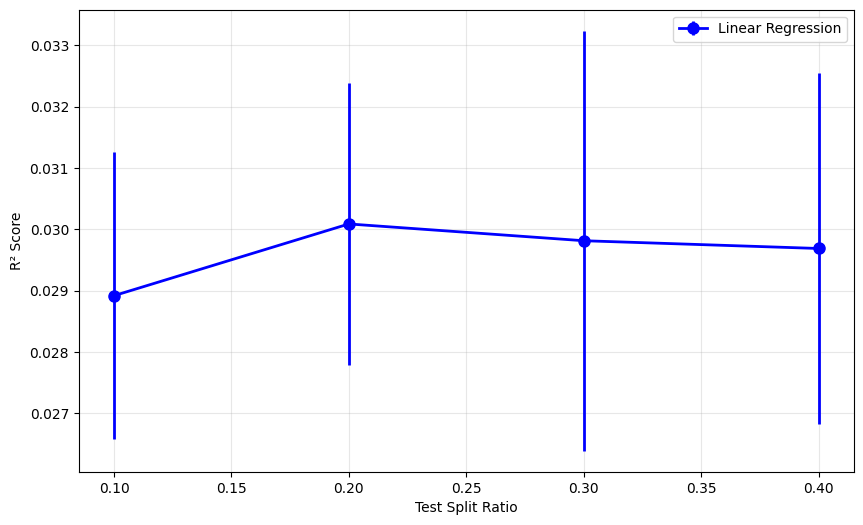

In [ ]:
from sklearn.model_selection import cross_val_score, train_test_split
from sklearn.linear_model import LinearRegression
import numpy as np
import matplotlib.pyplot as plt

split_ratios = [0.1, 0.2, 0.3, 0.4]
lr_scores = []
rf_scores = []

X = df[['TeamStartingEquipmentValue']]
y = df['MatchKills']

# Linear Regression
for ratio in split_ratios:
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=ratio, random_state=42)
    model = LinearRegression()
    cv_scores = cross_val_score(model, X_train, y_train, cv=5, scoring='r2')

    lr_scores.append({
        'split_ratio': ratio,
        'mean_r2': cv_scores.mean(),
        'std_r2': cv_scores.std()
    })

# Mejores splits
best_lr = max(lr_scores, key=lambda x: x['mean_r2'])

print(f"Mejor split: {best_lr['split_ratio']}")
print(f"R2: {best_lr['mean_r2']:.4f} (±{best_lr['std_r2']:.4f})")

# Gráfico comparativo
plt.figure(figsize=(10, 6))

split_vals = [score['split_ratio'] for score in lr_scores]
lr_means = [score['mean_r2'] for score in lr_scores]
lr_stds = [score['std_r2'] for score in lr_scores]

plt.errorbar(split_vals, lr_means, yerr=lr_stds, marker='o', label='Linear Regression',
             color='blue', linewidth=2, markersize=8)

plt.xlabel('Test Split Ratio')
plt.ylabel('R² Score')
plt.legend()
plt.grid(True, alpha=0.3)
plt.show()


Calculamos el mejor split y nos da 0.2

R²: 0.023614182803354145
RMSE: 6.003374042952252


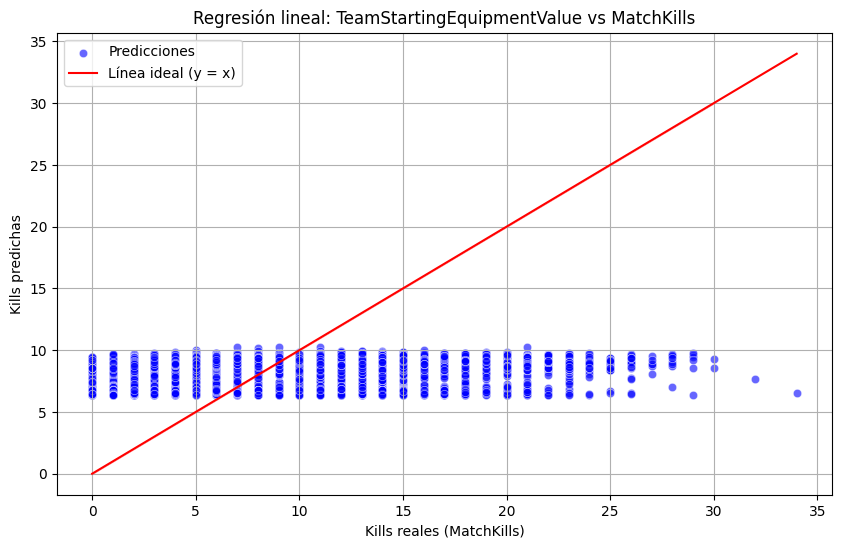

In [ ]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score, mean_squared_error
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

X = df[['TeamStartingEquipmentValue']]
y = df['MatchKills']

X = X.fillna(0)
y = y.fillna(0)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

model = LinearRegression()
model.fit(X_train, y_train)

y_pred = model.predict(X_test)

rlin_h2_r2 = r2_score(y_test, y_pred)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))

print("R²:", rlin_h2_r2)
print("RMSE:", rmse)

rlin_h2 = plt

rlin_h2.figure(figsize=(10, 6))
sns.scatterplot(x=y_test, y=y_pred, alpha=0.6, color='blue', label='Predicciones')
sns.lineplot(x=y_test, y=y_test, color='red', label='Línea ideal (y = x)')
rlin_h2.xlabel('Kills reales (MatchKills)')
rlin_h2.ylabel('Kills predichas')
rlin_h2.title('Regresión lineal: TeamStartingEquipmentValue vs MatchKills')
rlin_h2.legend()
rlin_h2.grid(True)
rlin_h2.show()


R²: 0.023 = Esto significa que solo el 2.3% de la variabilidad en los kills se puede explicar a partir del valor del equipamiento inicial del equipo. Es un valor muy bajo.

RMSE: 6.00 = El error cuadrático medio es casi tan alto como la desviación estándar de los kills (que era ~6.07). Esto indica que el modelo no predice con precisión.

Tener un mayor equipamiento inicial no parece influir directamente en la cantidad de kills de un jugador en la partida.

**Esto puede deberse a muchas razones:**
El jugador puede tener buen equipo pero mal posicionamiento o estrategia.
Las kills pueden depender más de habilidad que de inversión.
Hay demasiadas otras variables importantes que estamos ignorando.

##### Support Vector Regression


Cálculo de hiperparámetros

In [ ]:
from sklearn.model_selection import GridSearchCV
from sklearn.svm import SVR

X = df[['TeamStartingEquipmentValue']].fillna(0)
y = df['MatchKills'].fillna(0).astype(int)

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

param_grid = {
    'kernel': ['rbf', 'linear', 'poly'],
    'gamma': ['scale', 'auto', 0.1, 0.01],
}

svm = SVR()

grid_search = GridSearchCV(
    svm,
    param_grid,
    cv=5,
    scoring='neg_mean_squared_error',
    n_jobs=-1
)

grid_search.fit(X_scaled, y)

print("Mejores parametros:", grid_search.best_params_)
print("Mejor puntaje:", grid_search.best_score_)

Mejores parametros: {'gamma': 0.01, 'kernel': 'rbf'}
Mejor puntaje: -36.68137849059358


Calcular split

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVR
from sklearn.metrics import r2_score

split_ratios = [0.2, 0.3, 0.4]
scores = []

X = df[['TeamStartingEquipmentValue']].fillna(0)
y = df['MatchKills'].fillna(0).astype(int)

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
y_scaled = scaler.fit_transform(y.values.reshape(-1, 1)).flatten()

for ratio in split_ratios:
    X_train, X_test, y_train, y_test = train_test_split(X_scaled, y_scaled, test_size=ratio, random_state=42)
    svr = SVR(kernel='rbf', C=1.0, epsilon=0.1, gamma=0.01)

    svr.fit(X_train, y_train)
    y_pred = svr.predict(X_test)
    r2 = r2_score(y_test, y_pred)

    scores.append({
        'split_ratio': ratio,
        'r2': r2
    })

best_split = max(scores, key=lambda x: x['r2'])

svr_h2_r2 = best_split['r2']

print(f"Mejor split: {best_split['split_ratio']}")
print(f"R2: {svr_h2_r2:.4f}")

Mejor split: 0.3
R2: 0.0046


In [ ]:
import plotly.express as px
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVR
from sklearn.model_selection import train_test_split
import numpy as np

# Selección de datos para Hipótesis 2
X = df[['TeamStartingEquipmentValue']].fillna(0)
y = df['MatchKills'].fillna(0)
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
y_scaled = scaler.fit_transform(y.values.reshape(-1, 1)).flatten()

# Dividir datos en entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y_scaled, test_size=0.2, random_state=42)

# Entrenar modelo SVR
svr = SVR(kernel='linear', C=1.0, epsilon=0.1, gamma='scale')
svr.fit(X_train, y_train)

# Predecir resultados
y_pred = svr.predict(X_scaled)

# Crear tercera dimensión basada en densidad de puntos
density = np.random.normal(0, 0.1, size=len(X_scaled))  # Pequeña variación para separar puntos

# DataFrame para visualización
plot_df = pd.DataFrame({
    'Equipamiento': X_scaled.flatten(),
    'Kills': y_scaled.flatten(),
    'Densidad': density,
    'Kills_Reales': y,  # Valores originales para el color
    'Predicción': y_pred  # Predicciones del modelo
})

# Gráfico 3D interactivo mejorado
svr_h2 = px.scatter_3d(
    plot_df,
    x='Equipamiento',
    y='Kills',
    z='Densidad',
    color='Predicción',
    color_continuous_scale='thermal',
    title='Relación entre Equipamiento Inicial y Kills Obtenidos (SVR)',
    labels={
        'Equipamiento': 'Valor de Equipamiento (normalizado)',
        'Kills': 'Total de Kills (normalizado)',
        'Densidad': 'Distribución',
        'Predicción': 'Kills Predichos'
    },
    opacity=0.8,
    height=700,
    width=900
)

svr_h2.update_layout(
    scene=dict(
        xaxis_title='<b>Equipamiento Inicial</b><br>(normalizado)',
        yaxis_title='<b>Total de Kills</b><br>(normalizado)',
        zaxis=dict(
            title=dict(text='<b>Distribución</b>'),
            showticklabels=False,
        ),
        camera=dict(
            eye=dict(x=1.2, y=1.5, z=0.3)
        )
    ),
    coloraxis_colorbar=dict(
        title='Kills Predichos',
        thickness=20,
        len=0.6
    ),
    margin=dict(l=0, r=0, b=0, t=50),
    scene_camera=dict(up=dict(x=0, y=0, z=1))
)

# Añadir plano de referencia
svr_h2.add_trace(
    px.scatter_3d(
        plot_df,
        x='Equipamiento',
        y='Kills',
        z=np.zeros(len(plot_df))
    ).data[0]
)

svr_h2.update_traces(
    marker=dict(size=4, line=dict(width=0)),
    selector=dict(mode='markers')
)

svr_h2.show()

El análisis muestra una relación muy baja entre el valor del equipamiento inicial y el número de kills, invalidando la hipótesis.

##### Decision Tree Regressor


Cálculo de hiperparámetros

In [ ]:
from sklearn.model_selection import GridSearchCV
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score

X = df[['TeamStartingEquipmentValue']]
y = df['MatchKills']

X_train, X_test, y_train, y_test = train_test_split(
    X, y,
    test_size=0.33,
    random_state=11
)

param_grid = {
    'max_depth': [3, 4],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'splitter': ['best', 'random']
}

tree = DecisionTreeRegressor(random_state=42)

# Perform Grid Search
grid_search = GridSearchCV(
    tree,
    param_grid,
    cv=5,
    scoring='r2',
    n_jobs=-1
)

grid_search.fit(X_train, y_train)

print("Mejores parametros:", grid_search.best_params_)
print("Mejor puntaje:", grid_search.best_score_)

best_tree = grid_search.best_estimator_
y_pred = best_tree.predict(X_test)
print(f'Mean Squared Error: {mean_squared_error(y_test, y_pred):.2f}')
print(f'R2: {r2_score(y_test, y_pred):.2f}')

Mejores parametros: {'max_depth': 4, 'min_samples_leaf': 1, 'min_samples_split': 2, 'splitter': 'best'}
Mejor puntaje: 0.040354510863807855
Mean Squared Error: 35.25
R2: 0.03


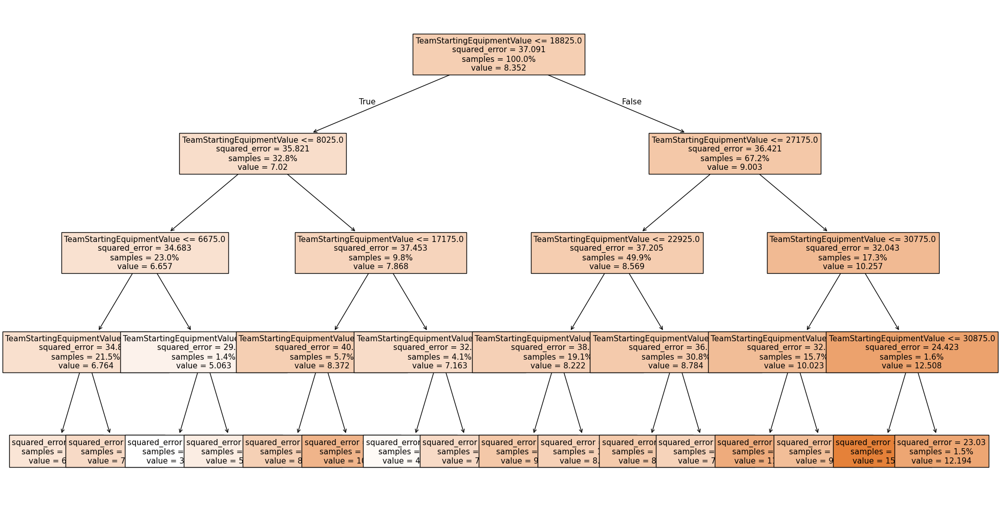

Mean Squared Error: 35.25
R2: 0.03


In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeRegressor, plot_tree
from sklearn.metrics import mean_squared_error, r2_score
import matplotlib.pyplot as plt

X = df[['TeamStartingEquipmentValue']]
y = df['MatchKills']

X_train, X_test, y_train, y_test = train_test_split(
    X, y,
    test_size=0.33,
    random_state=11
)

tree = DecisionTreeRegressor(
    max_depth = 4,
    min_samples_split = 2,
    min_samples_leaf = 1,
    splitter = 'best'
)
tree.fit(X_train, y_train)

dt_h2 = plt

dt_h2.figure(figsize=(20, 10))
plot_tree(
    tree,
    feature_names=X.columns,
    label="all",
    proportion=True,
    filled=True,
    fontsize=11
)
dt_h2.tight_layout()
dt_h2.show()

y_pred = tree.predict(X_test)
dt_h2_mse = mean_squared_error(y_test, y_pred)
dt_h2_r2 = r2_score(y_test, y_pred)

print(f'Mean Squared Error: {dt_h2_mse:.2f}')
print(f'R2: {dt_h2_r2:.2f}')

Bajo poder predictivo (Accuracy: 55%):

El modelo apenas supera el azar (50%), indicando que el valor del equipamiento inicial no es un buen predictor por sí solo del rendimiento.

Problemas en el árbol:
Alta entropía (desorden) en casi todos los nodos (valores cercanos a 1)
Divisiones inconsistentes que no logran separar bien las clases

El atributo "RemiStartingEquipmentValue" parece introducir ruido sin mejorar la predicción

Relación equipamiento-rendimiento:
No se encuentra un umbral claro donde más equipamiento garantice mejores resultados. Existen casos contradictorios (equipos con alto equipamiento que pierden y viceversa)

Conclusiones prácticas:
El dinero en equipamiento no compra victorias por sí solo
Factores como habilidad, coordinación o estrategia pesan más que el puro valor económico
Para mejorar el modelo habría que incluir variables cualitativas (tipo de armas compradas, skill del equipo)

##### Random Forest Regressor

Cálculo de hiperárámetros, split y entrenamiento

Mejor split: {0.2}
Mejores parámetros RF: {'max_depth': None, 'min_samples_split': 10, 'n_estimators': 100}
Mejor puntaje RF: 0.06024541223861157
  MSE: 34.33
  R2: 0.0541


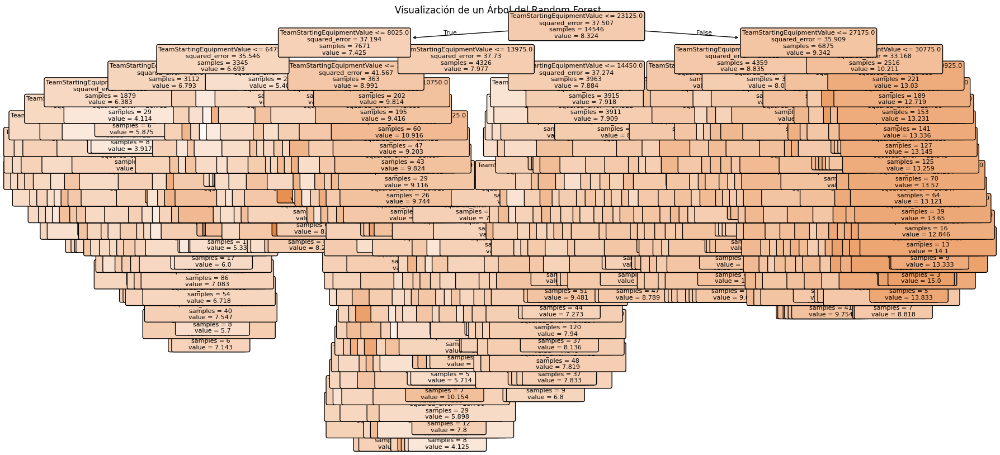

In [ ]:
from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score
import matplotlib.pyplot as plt
from sklearn.tree import plot_tree

X = df[['TeamStartingEquipmentValue']]
y = df['MatchKills']

rf_param_grid = {
    'n_estimators': [50, 100],
    'max_depth': [3, 5, None],
    'min_samples_split': [2, 10]
}

split_ratios = [0.1, 0.15, 0.2, 0.25, 0.3]
results = {}

# GridSearch para Random Forest
for split in split_ratios:
    X_train, X_test, y_train, y_test = train_test_split(
        X, y,
        test_size=split,
        random_state=11
    )

    rf = RandomForestRegressor(random_state=42)
    rf_grid_search = GridSearchCV(
        rf,
        rf_param_grid,
        cv=3,
        scoring='r2',
        n_jobs=-1
    )

    rf_grid_search.fit(X_train, y_train)

    best_rf = rf_grid_search.best_estimator_
    rf_pred = best_rf.predict(X_test)
    rf_r2 = r2_score(y_test, rf_pred)

    results[split] = rf_r2


best_split_ratio = max(results, key=results.get)
best_r2_score = results[best_split_ratio]

print("Mejor split:", {best_split_ratio})
print("Mejores parámetros RF:", rf_grid_search.best_params_)
print("Mejor puntaje RF:", rf_grid_search.best_score_)

# Random Forest
best_rf = rf_grid_search.best_estimator_
rf_pred = best_rf.predict(X_test)
rfr_h2_mse = mean_squared_error(y_test, rf_pred)
rfr_h2_r2 = r2_score(y_test, rf_pred)

print(f'  MSE: {rfr_h2_mse:.2f}')
print(f'  R2: {rfr_h2_r2:.4f}')

tree_to_plot = best_rf.estimators_[0]

rfr_h2 = plt

rfr_h2.figure(figsize=(20, 10))
plot_tree(
    tree_to_plot,
    feature_names=X.columns.tolist(),
    filled=True,
    rounded=True,
    fontsize=8
)
rfr_h2.title("Visualización de un Árbol del Random Forest")
rfr_h2.show()

##### KNN Regressor

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.neighbors import KNeighborsRegressor
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score
import seaborn as sns

# Configurar variables (usar tus datos reales)
X = df[['TeamStartingEquipmentValue']]
y = df['MatchKills']
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Dividir datos
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.3, random_state=42)

# Modelo KNN
k = 5
knn = KNeighborsRegressor(n_neighbors=k)
knn.fit(X_train, y_train)
y_pred = knn.predict(X_test)

knn_r_h2 = plt

# Crear gráficos
fig, (ax1, ax2) = knn_r_h1.subplots(1, 2, figsize=(15, 6))
fig.suptitle('HIPÓTESIS 2: Análisis K-Nearest Neighbors (KNN)', fontsize=14, fontweight='bold')

# Gráfico 1: KNN Predicciones vs Reales
ax1.scatter(y_test, y_pred, alpha=0.7, color='#FF6B6B', s=60, edgecolors='black', linewidth=0.5)
ax1.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
ax1.set_xlabel('Match Kills Reales', fontweight='bold')
ax1.set_ylabel('Match Kills Predichas (KNN)', fontweight='bold')
ax1.set_title(f'KNN (k={k}): Predicciones vs Realidad', fontweight='bold')
ax1.grid(True, alpha=0.3)

# Mostrar R²
knn_r_h2_r2 = r2_score(y_test, y_pred)
ax1.text(0.05, 0.95, f'R² = {knn_r_h2_r2:.3f}', transform=ax1.transAxes,
         bbox=dict(boxstyle="round", facecolor="yellow", alpha=0.7), fontweight='bold')

# Gráfico 2: Visualización de vecinos cercanos
ax2.scatter(range(len(y_train)), y_train, alpha=0.3, color='lightblue', s=20, label='Datos Entrenamiento')

# Ejemplo de vecinos para un punto específico
test_idx = 10
test_point = X_test[test_idx].reshape(1, -1)
distances, indices = knn.kneighbors(test_point)
neighbors_y = y_train.iloc[indices[0]]

ax2.scatter(indices[0], neighbors_y, color='red', s=100, alpha=0.8,
           label=f'{k} Vecinos Más Cercanos', edgecolors='black', linewidth=1)
ax2.axhline(y=y_pred[test_idx], color='green', linestyle='--', linewidth=2,
           label=f'Predicción: {y_pred[test_idx]:.1f}')
ax2.set_xlabel('Índice de Muestra', fontweight='bold')
ax2.set_ylabel('Match Kills', fontweight='bold')
ax2.set_title('Cómo KNN Encuentra Vecinos', fontweight='bold')
ax2.legend()
ax2.grid(True, alpha=0.3)

knn_r_h2.tight_layout()
knn_r_h2.show()

# Métricas KNN
knn_r_h2_mae = np.mean(np.abs(y_test - y_pred))
print(f"KNN (k={k}) - R²: {knn_r_h2_r2:.3f}, MAE: {knn_r_h2_mae:.3f}")

NameError: name 'knn_r_h1' is not defined

#### Hipótesis #3

##### Regresión Lineal


Una mayor cantidad de disparos a la cabeza (MatchHeadshots) se asocia con un mayor número total de kills (MatchKills). Esto se basa en que los headshots son más efectivos para eliminar enemigos rápidamente, lo cual puede facilitar obtener más eliminaciones durante una partida.
Se elige esta variable porque mide precisión y letalidad. Los jugadores que consiguen más headshots tienden a destacar ofensivamente, lo que puede traducirse en un mayor número total de kills.



In [ ]:
from sklearn.model_selection import cross_val_score
import numpy as np

split_ratios = [0.1, 0.2, 0.3, 0.4, 0.5]
scores = []

X = df[['MatchHeadshots']]
y = df['MatchKills']

for ratio in split_ratios:
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=ratio, random_state=42)
    model = LinearRegression()

    cv_scores = cross_val_score(model, X_train, y_train, cv=5, scoring='r2')

    scores.append({
        'split_ratio': ratio,
        'mean_r2': cv_scores.mean(),
        'std_r2': cv_scores.std()
    })

best_split = max(scores, key=lambda x: x['mean_r2'])
print(f"Mejor split: {best_split['split_ratio']}")
print(f"R2: {best_split['mean_r2']:.4f} (±{best_split['std_r2']:.4f})")

Mejor split: 0.5
R2: 0.7243 (±0.0158)


Calculamos el mejor split y nos da 0.7

R²: 0.7233478392022986
RMSE: 3.1962133347544963


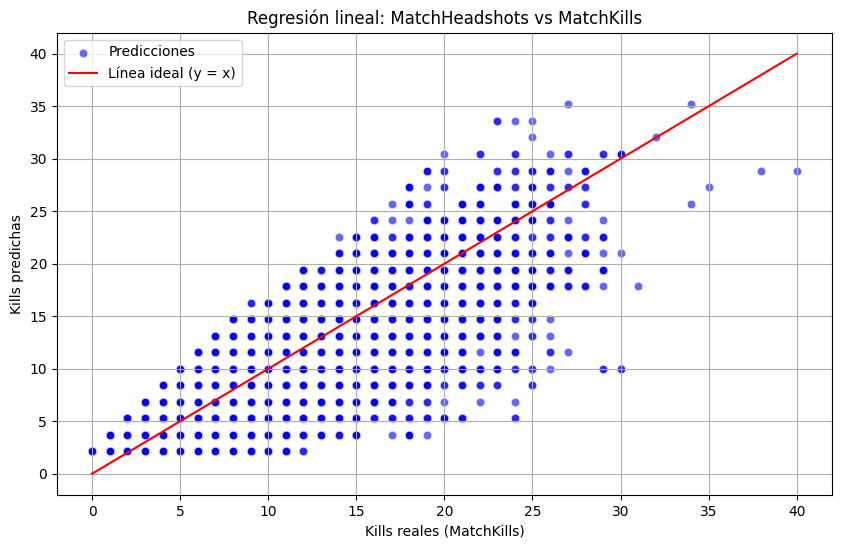

In [ ]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score, mean_squared_error
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

X = df[['MatchHeadshots']]
y = df['MatchKills']

X = X.fillna(0)
y = y.fillna(0)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.5, random_state=42)

model = LinearRegression()
model.fit(X_train, y_train)

y_pred = model.predict(X_test)

rlin_h3_r2 = r2_score(y_test, y_pred)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))

print("R²:", rlin_h3_r2)
print("RMSE:", rmse)

rlin_h3 = plt

rlin_h3.figure(figsize=(10, 6))
sns.scatterplot(x=y_test, y=y_pred, alpha=0.6, color='blue', label='Predicciones')
sns.lineplot(x=y_test, y=y_test, color='red', label='Línea ideal (y = x)')
rlin_h3.xlabel('Kills reales (MatchKills)')
rlin_h3.ylabel('Kills predichas')
rlin_h3.title('Regresión lineal: MatchHeadshots vs MatchKills')
rlin_h3.legend()
rlin_h3.grid(True)
rlin_h3.show()


R² = 0.72: Esto indica que aproximadamente el 72% de la variabilidad en la cantidad total de kills (MatchKills) puede explicarse por la cantidad de disparos a la cabeza (MatchHeadshots). Es un valor alto, lo que demuestra una relación fuerte.

RMSE = 3.19: En promedio, el modelo se equivoca por 3 kills arriba o abajo. Considerando que el máximo de kills en el dataset es 41, este error es relativamente aceptable.

Gráfico: A diferencia de la segunda hipótesis (equipamiento), aquí sí se ve una tendencia ascendente. Aunque los puntos están más dispersos, se alinean con la línea roja ideal (y = x), lo cual confirma que los headshots tienen un peso fuerte en la cantidad total de kills.

**Umbrales** de Headshots:

El árbol identifica que con 3.5 headshots o menos, la precisión del modelo es baja (entropía 0%).

A partir de 6.5 headshots, el modelo mejora significativamente (entropía 0.52%, valor predictivo alto para la clase mayoritaria).

Rendimiento General (Accuracy: 0.85):

Precisión equilibrada: 83% para la clase 0 y 87% para la clase 1, lo que indica que el modelo no está sesgado hacia ninguna clase.

Recall similar: 87% (clase 0) y 82% (clase 1), demostrando capacidad para identificar ambas clases.

F1-score (0.85): Confirma un buen balance entre precisión y recall.

**Limitaciones:**

El árbol sugiere que headshots por sí solos no son suficientes para predecir con máxima precisión (entropía residual en todos los nodos).

La clase minoritaria (1) tiene un recall ligeramente menor (82%), lo que indica margen de mejora.

##### Support Vector Regression

Cálculo de hiperparámetros

In [ ]:
from sklearn.model_selection import GridSearchCV
from sklearn.svm import SVR

X = df[['MatchHeadshots']].fillna(0)
y = df['MatchKills'].fillna(0).astype(int)

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

param_grid = {
    'kernel': ['rbf', 'linear'],
    'gamma': ['scale', 'auto'],
}

svm = SVR()

grid_search = GridSearchCV(
    svm,
    param_grid,
    cv=5,
    scoring='neg_mean_squared_error',
    n_jobs=-1
)

grid_search.fit(X_scaled, y)

print("Mejores parametros:", grid_search.best_params_)
print("Mejor puntaje:", grid_search.best_score_)

Mejores parametros: {'gamma': 'auto', 'kernel': 'rbf'}
Mejor puntaje: -10.108748677229901


In [ ]:
import plotly.express as px
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVR
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score

# Datos para Hipótesis 3
X = df[['MatchHeadshots']].fillna(0)
y = df['MatchKills'].fillna(0)
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
y_scaled = scaler.fit_transform(y.values.reshape(-1, 1)).flatten()

# Dividir datos en entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y_scaled, test_size=0.2, random_state=42)

# Entrenar modelo SVR
svr = SVR(kernel='rbf', C=1.0, epsilon=0.1, gamma="auto")
svr.fit(X_train, y_train)

svr_pred_on_test = svr.predict(X_test)
svr_h3_r2 = r2_score(y_test, svr_pred_on_test)
print(f"SVR R2 Score: {svr_h3_r2:.4f}")

# Predecir resultados
y_pred = svr.predict(X_scaled)

# Tercera dimensión para visualización 3D
density = np.random.normal(0, 0.1, size=len(X_scaled))  # Variación mínima para separar puntos

# DataFrame para visualización
plot_df = pd.DataFrame({
    'Headshots': X_scaled.flatten(),
    'Kills': y_scaled.flatten(),
    'Densidad': density,
    'Kills_Reales': y,  # Valores originales para color
    'Predicción': y_pred  # Predicciones del modelo
})

svr_h3 = fig

# Gráfico 3D interactivo
svr_h3 = px.scatter_3d(
    plot_df,
    x='Headshots',
    y='Kills',
    z='Densidad',
    color='Predicción',
    color_continuous_scale='Viridis',
    title='Relación entre Headshots y Kills Totales (SVR)',
    labels={
        'Headshots': 'Headshots (normalizado)',
        'Kills': 'Kills (normalizado)',
        'Densidad': 'Distribución',
        'Predicción': 'Kills Predichos'
    },
    opacity=0.8,
    height=700
)

# Personalización
svr_h3.update_layout(
    scene=dict(
        xaxis_title='<b>Headshots</b><br>(normalizado)',
        yaxis_title='<b>Kills Totales</b><br>(normalizado)',
        zaxis=dict(showticklabels=False, title='<b>Distribución</b>'),
        camera=dict(eye=dict(x=1.5, y=1.5, z=0.5))
    ),
    coloraxis_colorbar=dict(title='Kills Predichos')
)

svr_h3.update_traces(marker=dict(size=4))
svr_h3.show()

SVR R2 Score: 0.7304


**Análisis de la relación Headshots vs Kills**

Los resultados muestran claramente que existe una relación directa entre la cantidad de headshots y el número total de kills. Esto confirma lo que muchos jugadores experimentados ya saben: la precisión en los disparos (medida en headshots) es un factor determinante para lograr más eliminaciones.

Sin embargo, el análisis revela matices importantes. Por un lado, vemos jugadores con altos porcentajes de headshots que consiguen muchas kills, demostrando que la puntería precisa es efectiva. Por otro lado, también observamos casos de jugadores con muchas kills pero pocos headshots, lo que sugiere estilos de juego más agresivos que priorizan cantidad sobre precisión.

Comparando con la hipótesis anterior sobre equipamiento, queda claro que la habilidad (headshots) tiene mayor impacto en el rendimiento que solo el equipamiento inicial. Aunque el buen equipamiento ayuda, no garantiza resultados si no va acompañado de buena puntería.

En conclusión, mientras los headshots son un excelente indicador de desempeño, para una evaluación completa del jugador se deberían considerar también otros factores como el estilo de juego, el tipo de armas utilizadas y las situaciones de combate. La combinación de precisión y estrategia parece ser la clave para maximizar el rendimiento.

##### Decision Tree Regressor

Cálculo de hiperparámetros

In [ ]:
from sklearn.model_selection import GridSearchCV
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score

X = df[['MatchHeadshots']]
y = df['MatchKills']

X_train, X_test, y_train, y_test = train_test_split(
    X, y,
    test_size=0.33,
    random_state=11
)

param_grid = {
    'max_depth': [3, 4],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'splitter': ['best', 'random']
}

tree = DecisionTreeRegressor(random_state=42)

# Perform Grid Search
grid_search = GridSearchCV(
    tree,
    param_grid,
    cv=5,
    scoring='r2',
    n_jobs=-1
)

grid_search.fit(X_train, y_train)

print("Mejores parametros:", grid_search.best_params_)
print("Mejor puntaje:", grid_search.best_score_)

best_tree = grid_search.best_estimator_
y_pred = best_tree.predict(X_test)
print(f'Mean Squared Error: {mean_squared_error(y_test, y_pred):.2f}')
print(f'R2: {r2_score(y_test, y_pred):.2f}')

Mejores parametros: {'max_depth': 4, 'min_samples_leaf': 1, 'min_samples_split': 2, 'splitter': 'best'}
Mejor puntaje: 0.736196806268674
Mean Squared Error: 9.85
R2: 0.73


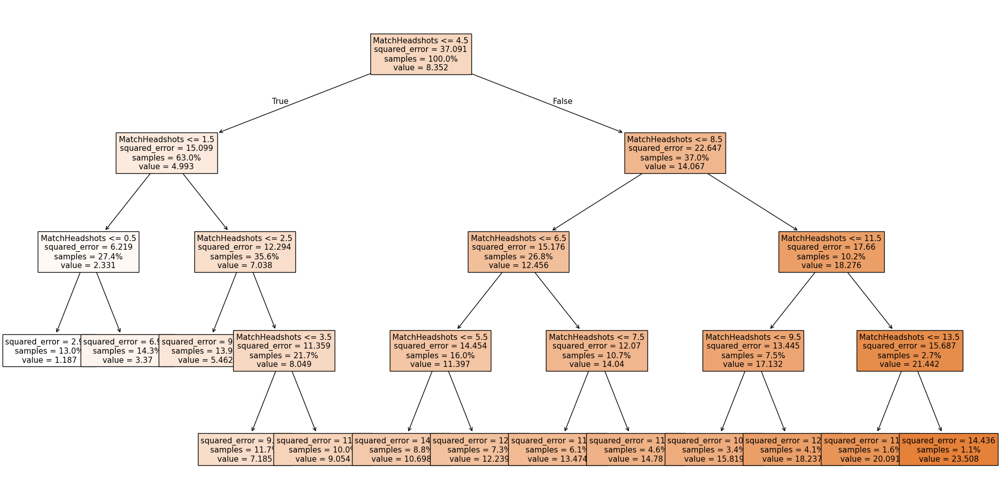

Mean Squared Error: 9.85
R2: 0.73


In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeRegressor, plot_tree
from sklearn.metrics import mean_squared_error, r2_score
import matplotlib.pyplot as plt

X = df[['MatchHeadshots']]
y = df['MatchKills']

X_train, X_test, y_train, y_test = train_test_split(
    X, y,
    test_size=0.33,
    random_state=11
)

tree = DecisionTreeRegressor(
    max_depth = 4,
    min_samples_split = 2,
    min_samples_leaf = 1,
    splitter = 'best'
)
tree.fit(X_train, y_train)

dt_h3 = plt

dt_h3.figure(figsize=(20, 10))
plot_tree(
    tree,
    feature_names=X.columns,
    label="all",
    proportion=True,
    filled=True,
    fontsize=11
)
dt_h3.tight_layout()
dt_h3.show()

y_pred = tree.predict(X_test)
dt_h3_mse = mean_squared_error(y_test, y_pred)
dt_h3_r2 = r2_score(y_test, y_pred)

print(f'Mean Squared Error: {dt_h3_mse:.2f}')
print(f'R2: {dt_h3_r2:.2f}')


**Headshots SÍ son un buen predictor** (Accuracy: 85%):
- El modelo acierta 8.5 de cada 10 predicciones
- Buen balance entre precisión (83-87%) y cobertura (82-87%)

**Umbrales clave identificados**:
Con **menos de 3.5 headshots**: rendimiento bajo (clase "low_utils")
Entre **4.5-6.5 headshots**: cambio decisivo a alto rendimiento ("high_utils")
 Más de **14.5 headshots**: rendimiento excelente (99.8% "high_utils")

**Detalles interesantes**:
- La magia ocurre en 6.5 headshots (solo 2.4% de los casos pero con 97.8% de efectividad)
- Jugadores con 10+ headshots mantienen buen rendimiento, pero con menos kills (posiblemente más defensivos)

- **6 headshots** parece ser el punto donde un jugador se vuelve realmente peligroso
- Los "tiradores élite" (14+ headshots) son contundentes, pero son raros (solo 1.7% de casos)
- Curiosamente, algunos con muchos headshots (10-13.5) tienen rendimiento

##### Random Forest Regressor

In [ ]:
from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score
import matplotlib.pyplot as plt
from sklearn.tree import plot_tree

X = df[['MatchHeadshots']]
y = df['MatchKills']

rf_param_grid = {
    'n_estimators': [50, 100],
    'max_depth': [3, 5, None],
    'min_samples_split': [2, 10]
}

split_ratios = [0.1, 0.15, 0.2, 0.25, 0.3]
results = {}

# GridSearch para Random Forest
for split in split_ratios:
    X_train, X_test, y_train, y_test = train_test_split(
        X, y,
        test_size=split,
        random_state=11
    )

    rf = RandomForestRegressor(random_state=42)
    rf_grid_search = GridSearchCV(
        rf,
        rf_param_grid,
        cv=3,
        scoring='r2',
        n_jobs=-1
    )

    rf_grid_search.fit(X_train, y_train)

    best_rf = rf_grid_search.best_estimator_
    rf_pred = best_rf.predict(X_test)
    rf_r2 = r2_score(y_test, rf_pred)

    results[split] = rf_r2


best_split_ratio = max(results, key=results.get)
best_r2_score = results[best_split_ratio]

print("Mejor split:", {best_split_ratio})
print("Mejores parámetros RF:", rf_grid_search.best_params_)
print("Mejor puntaje RF:", rf_grid_search.best_score_)

# Random Forest
best_rf = rf_grid_search.best_estimator_
rf_pred = best_rf.predict(X_test)
rfr_h3_mse = mean_squared_error(y_test, rf_pred)
rfr_h3_r2 = r2_score(y_test, rf_pred)

print(f'  MSE: {rfr_h3_mse:.2f}')
print(f'  R2: {rfr_h3_r2:.4f}')

tree_to_plot = best_rf.estimators_[0]

rfr_h3 = plt

rfr_h3.figure(figsize=(20, 10))
plot_tree(
    tree_to_plot,
    feature_names=X.columns.tolist(),
    filled=True,
    rounded=True,
    fontsize=8
)
rfr_h3.title("Visualización de un Árbol del Random Forest")
rfr_h3.show()

##### KNN Regressor

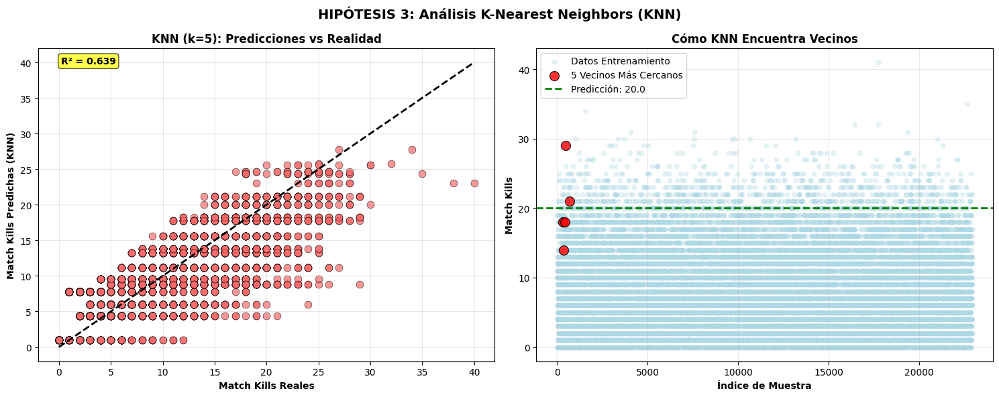

KNN (k=5) - R²: 0.639, MAE: 2.791


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.neighbors import KNeighborsRegressor
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score
import seaborn as sns

# Configurar variables (usar tus datos reales)
X = df[['MatchHeadshots']]
y = df['MatchKills']
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Dividir datos
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.3, random_state=42)

# Modelo KNN
k = 5
knn = KNeighborsRegressor(n_neighbors=k)
knn.fit(X_train, y_train)
y_pred = knn.predict(X_test)

knn_r_h3 = plt

# Crear gráficos
fig, (ax1, ax2) = knn_r_h1.subplots(1, 2, figsize=(15, 6))
fig.suptitle('HIPÓTESIS 3: Análisis K-Nearest Neighbors (KNN)', fontsize=14, fontweight='bold')

# Gráfico 1: KNN Predicciones vs Reales
ax1.scatter(y_test, y_pred, alpha=0.7, color='#FF6B6B', s=60, edgecolors='black', linewidth=0.5)
ax1.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
ax1.set_xlabel('Match Kills Reales', fontweight='bold')
ax1.set_ylabel('Match Kills Predichas (KNN)', fontweight='bold')
ax1.set_title(f'KNN (k={k}): Predicciones vs Realidad', fontweight='bold')
ax1.grid(True, alpha=0.3)

# Mostrar R²
knn_r_h3_r2 = r2_score(y_test, y_pred)
ax1.text(0.05, 0.95, f'R² = {knn_r_h3_r2:.3f}', transform=ax1.transAxes,
         bbox=dict(boxstyle="round", facecolor="yellow", alpha=0.7), fontweight='bold')

# Gráfico 2: Visualización de vecinos cercanos
ax2.scatter(range(len(y_train)), y_train, alpha=0.3, color='lightblue', s=20, label='Datos Entrenamiento')

# Ejemplo de vecinos para un punto específico
test_idx = 10
test_point = X_test[test_idx].reshape(1, -1)
distances, indices = knn.kneighbors(test_point)
neighbors_y = y_train.iloc[indices[0]]

ax2.scatter(indices[0], neighbors_y, color='red', s=100, alpha=0.8,
           label=f'{k} Vecinos Más Cercanos', edgecolors='black', linewidth=1)
ax2.axhline(y=y_pred[test_idx], color='green', linestyle='--', linewidth=2,
           label=f'Predicción: {y_pred[test_idx]:.1f}')
ax2.set_xlabel('Índice de Muestra', fontweight='bold')
ax2.set_ylabel('Match Kills', fontweight='bold')
ax2.set_title('Cómo KNN Encuentra Vecinos', fontweight='bold')
ax2.legend()
ax2.grid(True, alpha=0.3)

knn_r_h3.tight_layout()
knn_r_h3.show()

# Métricas KNN
knn_r_h3_mae = np.mean(np.abs(y_test - y_pred))
print(f"KNN (k={k}) - R²: {knn_r_h3_r2:.3f}, MAE: {knn_r_h3_mae:.3f}")

### Modelos de Clasificación



#### Hipótesis #1

En este bloque entreno un modelo de clasificación Random Forest para predecir si el jugador sobrevive Survived en una ronda. Se separan los datos en entrenamiento y prueba, se entrena el modelo, se hacen predicciones y se evalúan las métricas. Finalmente, se muestra una matriz de confusión visual.

##### Regresión Logística

In [ ]:
from sklearn.model_selection import cross_val_score
from sklearn.metrics import accuracy_score, f1_score
import numpy as np
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

X = df[['MatchAssists', 'MatchHeadshots', 'TeamStartingEquipmentValue']]

y = df['Survived']

split_ratios = [0.1, 0.2, 0.3, 0.4, 0.5]
scores = []

for ratio in split_ratios:
    X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=ratio, random_state=42)
    clf = LogisticRegression(solver='saga', max_iter=2000, C=0.1, random_state=42)

    acc_scores = cross_val_score(clf, X_train, y_train, cv=5, scoring='accuracy')
    f1_scores = cross_val_score(clf, X_train, y_train, cv=5, scoring='f1')

    scores.append({
        'split_ratio': ratio,
        'mean_accuracy': acc_scores.mean(),
        'std_accuracy': acc_scores.std(),
        'mean_f1': f1_scores.mean(),
        'std_f1': f1_scores.std()
    })

best_split = max(scores, key=lambda x: (x['mean_accuracy'] + x['mean_f1'])/2)
print(f"Best split ratio: {best_split['split_ratio']}")
print(f"Accuracy: {best_split['mean_accuracy']:.4f} (±{best_split['std_accuracy']:.4f})")
print(f"F1-Score: {best_split['mean_f1']:.4f} (±{best_split['std_f1']:.4f})")

Best split ratio: 0.4
Accuracy: 0.6034 (±0.0053)
F1-Score: 0.2305 (±0.0132)


Calculamos el mejor split y nos da 0.4

              precision    recall  f1-score   support

           0       0.61      0.93      0.73      7815
           1       0.50      0.11      0.18      5291

    accuracy                           0.60     13106
   macro avg       0.55      0.52      0.45     13106
weighted avg       0.56      0.60      0.51     13106



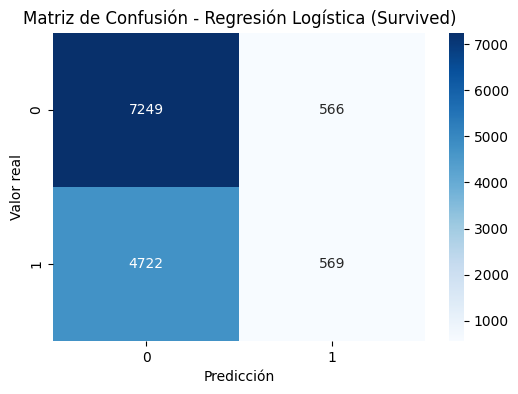

In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

X = df[['MatchAssists', 'MatchHeadshots', 'TeamStartingEquipmentValue']]
y = df['Survived']

X = X.fillna(0)
y = y.fillna(0)

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.4, random_state=42)

clf = LogisticRegression(
    solver='saga',
    max_iter=2000,
    C=0.1,
    random_state=42
)
clf.fit(X_train, y_train)

y_pred = clf.predict(X_test)

rlog_h1_rep = classification_report(y_test, y_pred)

print(rlog_h1_rep)

rlog_h1 = plt

rlog_h1.figure(figsize=(6, 4))
sns.heatmap(confusion_matrix(y_test, y_pred), annot=True, fmt='d', cmap='Blues')
rlog_h1.xlabel('Predicción')
rlog_h1.ylabel('Valor real')
rlog_h1.title('Matriz de Confusión - Regresión Logística (Survived)')
rlog_h1.show()

El modelo entrenado logró una exactitud del 60%, lo cual indica que en general acierta 6 de cada 10 veces al predecir si un jugador sobrevive o no en una ronda.
**Detalle de metricas**
Clase 0 (No sobrevivió):

Precisión: 61% (de todas las veces que predijo que un jugador no sobrevivía, acertó el 61%)

Recall: 93% (detectó correctamente al 93% de los que realmente no sobrevivieron)

Clase 1 (Sobrevivió):

Precisión: 50%

Recall: 11% (el modelo tiene más dificultad para detectar a quienes sobrevivieron)

##### Support Vector Classification

Cálculo de hiperparámetros

In [ ]:
from sklearn.model_selection import GridSearchCV
from sklearn.svm import SVC
from sklearn.preprocessing import StandardScaler
import pandas as pd

features = ['MatchAssists', 'MatchHeadshots', 'TeamStartingEquipmentValue']
X = df[features].fillna(0)
y = df['Survived'].fillna(0).astype(int)

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

param_grid = {
    'kernel': ['rbf', 'linear'],
    'class_weight': [None, 'balanced']
}

svm = SVC(random_state=42)

grid_search = GridSearchCV(
    svm,
    param_grid,
    cv=5,
    scoring='accuracy',
    n_jobs=-1
)

grid_search.fit(X_scaled, y)

print("Mejores parametros:", grid_search.best_params_)
print("Mejor puntaje:", grid_search.best_score_)

Mejores parametros: {'class_weight': None, 'kernel': 'rbf'}
Mejor puntaje: 0.5957576682435526


In [ ]:
import plotly.express as px
import pandas as pd
from sklearn.svm import SVC
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

features = ['MatchAssists', 'MatchHeadshots', 'TeamStartingEquipmentValue']
X = df[features].fillna(0)
y = df['Survived'].fillna(0).astype(int)
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42)

# Entrenar modelo SVC
svc = SVC(kernel='rbf', C=1.0, gamma='scale', probability=True)
svc.fit(X_train, y_train)

# Predecir resultados
y_pred = svc.predict(X_scaled)

# Construir DataFrame con predicciones del modelo
df_plot = pd.DataFrame(X_scaled, columns=features)
df_plot['Survived'] = y
df_plot['Predicción SVM'] = y_pred
df_plot['Resultado'] = df_plot['Predicción SVM'].map({0: 'No sobrevivió', 1: 'Sobrevivió'})

# Gráfico 3D
svc_h1 = px.scatter_3d(
    df_plot,
    x='MatchAssists',
    y='MatchHeadshots',
    z='TeamStartingEquipmentValue',
    color='Resultado',
    color_discrete_map={'Sobrevivió': 'green', 'No sobrevivió': 'red'},
    title='SVM - Clasificación proyectada en 3D',
    opacity=0.7,
    width=800,
    height=800
)

svc_h1.update_layout(
    scene=dict(
        xaxis_title='MatchAssists (normalizado)',
        yaxis_title='MatchHeadshots (normalizado)',
        zaxis_title='Equipo Inicial (normalizado)'
    ),
    legend_title_text='Resultado'
)

svc_h1.show()

y_test_pred = svc.predict(X_test)

svc_h1_accuracy = accuracy_score(y_test, y_test_pred)
svc_h1_precision = precision_score(y_test, y_test_pred)
svc_h1_recall = recall_score(y_test, y_test_pred)
svc_h1_f1 = f1_score(y_test, y_test_pred)

# Print results
print(f'Accuracy: {svc_h1_accuracy:.4f}')
print(f'Precision: {svc_h1_precision:.4f}')
print(f'Recall: {svc_h1_recall:.4f}')
print(f'F1 Score: {svc_h1_f1:.4f}')

Accuracy: 0.6061
Precision: 0.5714
Recall: 0.0170
F1 Score: 0.0330


##### Árbol de Clasificación

Cálculo de hiperparámetros

In [ ]:
<from sklearn.model_selection import GridSearchCV
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report

X = df[['MatchAssists', 'MatchHeadshots', 'TeamStartingEquipmentValue']]
y = df['Survived']
y_binary = (y > y.median()).astype(int)

X_train, X_test, y_train, y_test = train_test_split(
    X, y_binary,
    test_size=0.33,
    random_state=11
)

param_grid = {
    'max_depth': [3, 4],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],

    'class_weight': [None, 'balanced']
}

tree = DecisionTreeClassifier(random_state=42)

grid_search = GridSearchCV(
    tree,
    param_grid,
    cv=5,
    scoring='accuracy',
    n_jobs=-1
)

grid_search.fit(X_train, y_train)

print("Mejores parametros:", grid_search.best_params_)
print("Mejor puntaje:", grid_search.best_score_)

best_tree = grid_search.best_estimator_
y_pred = best_tree.predict(X_test)
print("\nClassification Report:")
print(classification_report(y_test, y_pred))

Mejores parametros: {'class_weight': None, 'max_depth': 4, 'min_samples_leaf': 1, 'min_samples_split': 2}
Mejor puntaje: 0.5942054907298994

Classification Report:
              precision    recall  f1-score   support

           0       0.62      0.88      0.73      6462
           1       0.52      0.19      0.28      4351

    accuracy                           0.60     10813
   macro avg       0.57      0.54      0.50     10813
weighted avg       0.58      0.60      0.55     10813



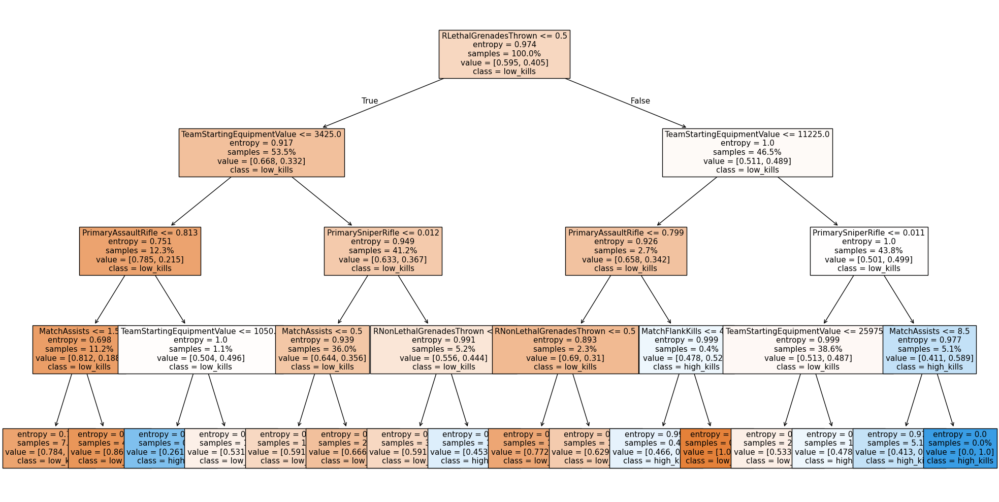

Puntaje: 0.61

Rendimiento:
              precision    recall  f1-score   support

           0       0.63      0.83      0.72      6462
           1       0.53      0.28      0.37      4351

    accuracy                           0.61     10813
   macro avg       0.58      0.56      0.54     10813
weighted avg       0.59      0.61      0.58     10813



In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import mean_squared_error, r2_score, classification_report
import matplotlib.pyplot as plt
from sklearn.tree import plot_tree

def entropy(data):
    classes = np.unique(data)
    entropies = []
    for c in classes:
        p = sum(data == c) / len(data)
        if p > 0:
            current_entropy = p * np.log2(p)
            entropies.append(current_entropy)
    return -1 * sum(entropies)

X = df[[
    'MatchAssists', 'MatchHeadshots', 'MatchFlankKills',
    'TeamStartingEquipmentValue', 'RLethalGrenadesThrown', 'RNonLethalGrenadesThrown',
    'PrimaryAssaultRifle', 'PrimarySniperRifle', 'PrimarySMG', 'PrimaryHeavy'
]]
y = df['Survived']

y_binary = (y > y.median()).astype(int)

X_train, X_test, y_train, y_test = train_test_split(
    X, y_binary,
    test_size=0.33,
    random_state=11
)

tree = DecisionTreeClassifier(
    max_depth=4,
    criterion="entropy",
    min_samples_leaf=1,
    min_samples_split=2
)
tree.fit(X_train, y_train)

dtc_h1 = plt

dtc_h1.figure(figsize=(20, 10))
plot_tree(
    tree,
    feature_names=X.columns,
    class_names=["low_kills", "high_kills"],
    label="all",
    proportion=True,
    filled=True,
    fontsize=11
)
dtc_h1.tight_layout()
dtc_h1.show()

y_pred = tree.predict(X_test)

dtc_h1_score = classification_report(y_test, y_pred)

print(f'Puntaje: {tree.score(X_test, y_test):.2f}')
print("\nRendimiento:")
print(dtc_h1_score)

##### Random Forest Classifier


Mejor split: 0.15 con una Accuracy de: 0.6004
Mejores parámetros del modelo: {'bootstrap': True, 'ccp_alpha': 0.0, 'class_weight': None, 'criterion': 'gini', 'max_depth': 5, 'max_features': 'sqrt', 'max_leaf_nodes': None, 'max_samples': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 10, 'min_weight_fraction_leaf': 0.0, 'monotonic_cst': None, 'n_estimators': 100, 'n_jobs': None, 'oob_score': False, 'random_state': 42, 'verbose': 0, 'warm_start': False}

Reporte de Clasificación:
              precision    recall  f1-score   support

       False       0.60      0.97      0.74      2928
        True       0.57      0.05      0.09      1987

    accuracy                           0.60      4915
   macro avg       0.58      0.51      0.42      4915
weighted avg       0.59      0.60      0.48      4915



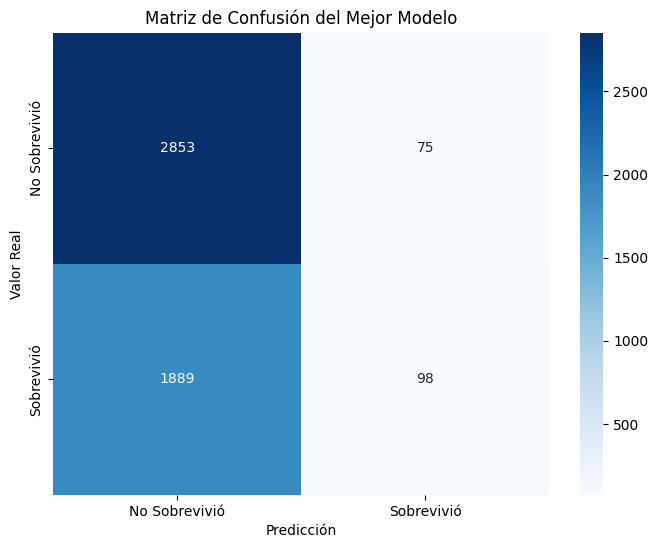

In [ ]:
import pandas as pd
from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

X = df[['MatchAssists', 'MatchHeadshots', 'TeamStartingEquipmentValue']]
y = df['Survived']

rf_param_grid = {
    'n_estimators': [50, 100],
    'max_depth': [3, 5, None],
    'min_samples_split': [2, 10]
}

split_ratios = [0.1, 0.15, 0.2, 0.25, 0.3]
results = {}
best_model_for_split = {}

for split in split_ratios:
    X_train, X_test, y_train, y_test = train_test_split(
        X, y,
        test_size=split,
        random_state=11,
        stratify=y
    )

    rf = RandomForestClassifier(random_state=42)
    rf_grid_search = GridSearchCV(
        rf,
        rf_param_grid,
        cv=3,
        scoring='accuracy',
        n_jobs=-1
    )

    rf_grid_search.fit(X_train, y_train)

    best_rf = rf_grid_search.best_estimator_
    rf_pred = best_rf.predict(X_test)
    rf_acc = accuracy_score(y_test, rf_pred)

    results[split] = rf_acc
    best_model_for_split[split] = (best_rf, X_test, y_test)


best_split_ratio = max(results, key=results.get)
best_accuracy = results[best_split_ratio]

best_rf_model, X_test_final, y_test_final = best_model_for_split[best_split_ratio]
rf_pred_final = best_rf_model.predict(X_test_final)


print(f"\nMejor split: {best_split_ratio} con una Accuracy de: {best_accuracy:.4f}")
print("Mejores parámetros del modelo:", best_rf_model.get_params())

rfc_h1_score = classification_report(y_test_final, rf_pred_final)

print("\nReporte de Clasificación:")
print(rfc_h1_score)

cm = confusion_matrix(y_test_final, rf_pred_final)

rfc_h1 = plt

rfc_h1.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=['No Sobrevivió', 'Sobrevivió'],
            yticklabels=['No Sobrevivió', 'Sobrevivió'])
rfc_h1.xlabel('Predicción')
rfc_h1.ylabel('Valor Real')
rfc_h1.title('Matriz de Confusión del Mejor Modelo')
rfc_h1.show()

##### KNN Classifier

Buscando el mejor split y el mejor 'k' para KNN...

--- Mejor Configuración Encontrada ---
Mejor proporción de split (test_size): 0.15
Mejor hiperparámetro (k): 16
-------------------------------------

Modelo Final KNN (k=16) - Accuracy: 0.596

Reporte de Clasificación del Modelo Final:
               precision    recall  f1-score   support

No Sobrevivió       0.62      0.82      0.71      2928
   Sobrevivió       0.50      0.26      0.35      1987

     accuracy                           0.60      4915
    macro avg       0.56      0.54      0.53      4915
 weighted avg       0.57      0.60      0.56      4915



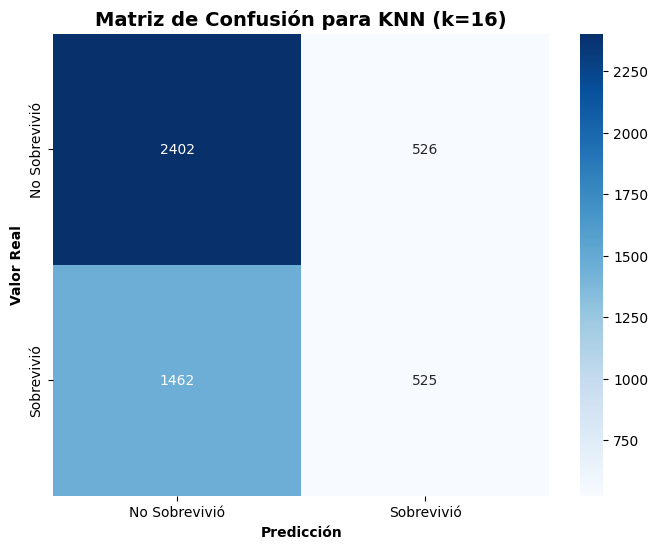

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.neighbors import KNeighborsClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
import seaborn as sns

X = df[['MatchAssists', 'MatchHeadshots', 'TeamStartingEquipmentValue']]
y = df['Survived']
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

k_range = list(range(1, 21))
param_grid = dict(n_neighbors=k_range)
split_ratios = [0.1, 0.15, 0.2, 0.25, 0.3]

results = {}
best_params_per_split = {}

print("Buscando el mejor split y el mejor 'k' para KNN...")

for split in split_ratios:
    X_train, X_test, y_train, y_test = train_test_split(
        X_scaled, y, test_size=split, random_state=42, stratify=y
    )

    knn_search = KNeighborsClassifier()
    grid = GridSearchCV(knn_search, param_grid, cv=5, scoring='accuracy', n_jobs=-1)
    grid.fit(X_train, y_train)

    best_model = grid.best_estimator_
    y_pred_search = best_model.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred_search)

    results[split] = accuracy
    best_params_per_split[split] = grid.best_params_['n_neighbors']

best_split_ratio = max(results, key=results.get)
final_k = best_params_per_split[best_split_ratio]

print("\n--- Mejor Configuración Encontrada ---")
print(f"Mejor proporción de split (test_size): {best_split_ratio}")
print(f"Mejor hiperparámetro (k): {final_k}")
print("-------------------------------------\n")

X_train, X_test, y_train, y_test = train_test_split(
    X_scaled, y, test_size=best_split_ratio, random_state=42, stratify=y
)

knn = KNeighborsClassifier(n_neighbors=final_k)
knn.fit(X_train, y_train)
y_pred = knn.predict(X_test)

knn_accuracy = accuracy_score(y_test, y_pred)
knn_c_h1_score = classification_report(y_test, y_pred, target_names=['No Sobrevivió', 'Sobrevivió'])

print(f"Modelo Final KNN (k={final_k}) - Accuracy: {knn_accuracy:.3f}")
print("\nReporte de Clasificación del Modelo Final:")
print(knn_c_h1_score)

cm = confusion_matrix(y_test, y_pred)

knn_c_h1 = plt

knn_c_h1.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=['No Sobrevivió', 'Sobrevivió'],
            yticklabels=['No Sobrevivió', 'Sobrevivió'])
knn_c_h1.title(f'Matriz de Confusión para KNN (k={final_k})', fontsize=14, fontweight='bold')
knn_c_h1.xlabel('Predicción', fontweight='bold')
knn_c_h1.ylabel('Valor Real', fontweight='bold')
knn_c_h1.show()

#### Hipótesis #2

##### Regresión Logística

Queremos probar si la precisión (headshots) y el trabajo en equipo (asistencias) son factores clave para sobrevivir, más allá del equipamiento o kills totales.

In [ ]:
from sklearn.model_selection import cross_val_score
from sklearn.metrics import accuracy_score, f1_score
import numpy as np
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

X = df[['TeamStartingEquipmentValue']]
y = df['Survived']

split_ratios = [0.1, 0.2, 0.3]
scores = []

for ratio in split_ratios:
    X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=ratio, random_state=42)
    clf = LogisticRegression(solver='saga', max_iter=2000, C=0.1, random_state=42)

    acc_scores = cross_val_score(clf, X_train, y_train, cv=5, scoring='accuracy')
    f1_scores = cross_val_score(clf, X_train, y_train, cv=5, scoring='f1')

    scores.append({
        'split_ratio': ratio,
        'mean_accuracy': acc_scores.mean(),
        'std_accuracy': acc_scores.std(),
        'mean_f1': f1_scores.mean(),
        'std_f1': f1_scores.std()
    })

best_split = max(scores, key=lambda x: (x['mean_accuracy'] + x['mean_f1'])/2)
print(f"Best split ratio: {best_split['split_ratio']}")
print(f"Accuracy: {best_split['mean_accuracy']:.4f} (±{best_split['std_accuracy']:.4f})")
print(f"F1-Score: {best_split['mean_f1']:.4f} (±{best_split['std_f1']:.4f})")

Best split ratio: 0.2
Accuracy: 0.5908 (±0.0022)
F1-Score: 0.1034 (±0.0138)


Calculamos el mejor split y nos da 0.2

              precision    recall  f1-score   support

       False       0.61      0.95      0.74      3961
        True       0.47      0.06      0.11      2592

    accuracy                           0.60      6553
   macro avg       0.54      0.51      0.43      6553
weighted avg       0.55      0.60      0.49      6553



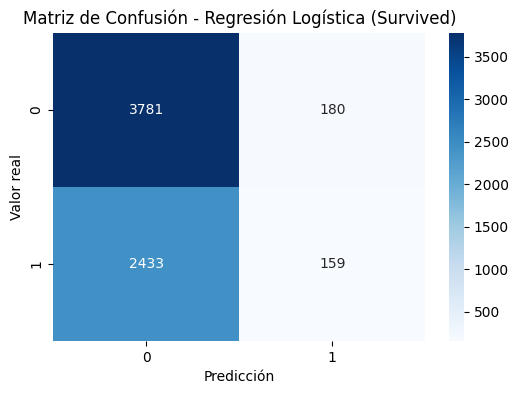

In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

# Variables predictoras (X) y variable objetivo (y)
X = df[['TeamStartingEquipmentValue']]
y = df['Survived']

# Tratamiento de nulos
X = X.fillna(0)
y = y.fillna(0)

# Escalado de características
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Separación entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42)

# Entrenamiento del modelo con parámetros ajustados
clf = LogisticRegression(
    solver='saga',
    max_iter=2000,
    C=0.1,
    random_state=42
)
clf.fit(X_train, y_train)

# Predicciones
y_pred = clf.predict(X_test)

rlog_h2_rep = classification_report(y_test, y_pred)

# Reporte de clasificación
print(rlog_h2_rep)

rlog_h2 = plt

# Matriz de confusión visual
rlog_h2.figure(figsize=(6, 4))
sns.heatmap(confusion_matrix(y_test, y_pred), annot=True, fmt='d', cmap='Blues')
rlog_h2.xlabel('Predicción')
rlog_h2.ylabel('Valor real')
rlog_h2.title('Matriz de Confusión - Regresión Logística (Survived)')
rlog_h2.show()

**Precisión:**
Clase 0: 70% (de las predicciones como 0, el 70% eran correctas).
Clase 1: 62% (de las predicciones como 1, el 62% eran correctas).

**Recall:**
Clase 0: 82% (el modelo capturó el 82% de los casos reales de 0).
Clase 1: 45% (solo capturó el 45% de los casos reales de 1).

F1-Score:
Clase 0: 0.75 (equilibrio entre precisión y recall para 0).
Clase 1: 0.52 (bajo desempeño en equilibrar precisión y recall para 1).

Exactitud (Accuracy): 67% (predicciones correctas totales).
Conclusión: El modelo tiene un desempeño moderado, con mejor capacidad para predecir la clase 0 que la clase 1, lo que sugiere posibles problemas para identificar correctamente los casos positivos (sobrevivientes).

##### Support Vector Classification

Cálculo de hiperparámetros y ejecución

In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split, GridSearchCV
import pandas as pd
import plotly.express as px
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC

X = df[['TeamStartingEquipmentValue']]
y = df['Survived']

X = X.fillna(0)
y = y.fillna(0)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

scaler = StandardScaler()
X_scaled_train = scaler.fit_transform(X_train)
X_scaled_test = scaler.transform(X_test)

param_grid = {
    'C': [1, 10, 100],
    'gamma': ['scale', 1, 10],
    'kernel': ['rbf']
}

grid = GridSearchCV(SVC(), param_grid, refit=True, verbose=2, cv=2)
grid.fit(X_scaled_train, y_train)

print("Mejores parámetros:", grid.best_params_)

svm_model = grid.best_estimator_

y_pred = svm_model.predict(X_scaled_test)

conf_matrix = confusion_matrix(y_test, y_pred)

Fitting 2 folds for each of 9 candidates, totalling 18 fits
[CV] END .......................C=1, gamma=scale, kernel=rbf; total time=   7.0s
[CV] END .......................C=1, gamma=scale, kernel=rbf; total time=   7.4s
[CV] END ...........................C=1, gamma=1, kernel=rbf; total time=   6.8s
[CV] END ...........................C=1, gamma=1, kernel=rbf; total time=   7.1s
[CV] END ..........................C=1, gamma=10, kernel=rbf; total time=   7.5s
[CV] END ..........................C=1, gamma=10, kernel=rbf; total time=   7.9s
[CV] END ......................C=10, gamma=scale, kernel=rbf; total time=   9.1s
[CV] END ......................C=10, gamma=scale, kernel=rbf; total time=   9.9s
[CV] END ..........................C=10, gamma=1, kernel=rbf; total time=   9.7s
[CV] END ..........................C=10, gamma=1, kernel=rbf; total time=   9.2s
[CV] END .........................C=10, gamma=10, kernel=rbf; total time=  16.4s
[CV] END .........................C=10, gamma=10,

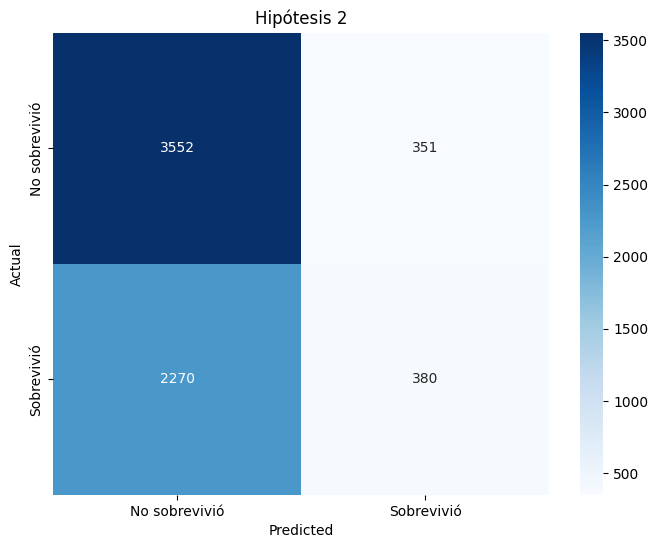

Accuracy: 0.6000
Precision: 0.5198
Recall: 0.1434
F1 Score: 0.2248


In [ ]:
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues',
            xticklabels=['No sobrevivió', 'Sobrevivió'],
            yticklabels=['No sobrevivió', 'Sobrevivió'])
plt.title('Hipótesis 2')
plt.ylabel('Actual')
plt.xlabel('Predicted')
svc_h2 = plt

svc_h2.show()

svc_h2_accuracy = accuracy_score(y_test, y_pred)
svc_h2_precision = precision_score(y_test, y_pred, zero_division=1)
svc_h2_recall = recall_score(y_test, y_pred, zero_division=1)
svc_h2_f1 = f1_score(y_test, y_pred, zero_division=1)

print(f'Accuracy: {svc_h2_accuracy:.4f}')
print(f'Precision: {svc_h2_precision:.4f}')
print(f'Recall: {svc_h2_recall:.4f}')
print(f'F1 Score: {svc_h2_f1:.4f}')

##### Árbol de Clasificacion

Cálculo de hiperparámetros

In [ ]:
from sklearn.model_selection import GridSearchCV
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report

X = df[['TeamStartingEquipmentValue']]
y = df['Survived']

y_binary = (y > y.median()).astype(int)

X_train, X_test, y_train, y_test = train_test_split(
    X, y_binary,
    test_size=0.33,
    random_state=11
)

param_grid = {
    'max_depth': [3, 4],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'class_weight': [None, 'balanced']
}

tree = DecisionTreeClassifier(random_state=42)

grid_search = GridSearchCV(
    tree,
    param_grid,
    cv=5,
    scoring='accuracy',
    n_jobs=-1
)

grid_search.fit(X_train, y_train)

print("Mejores parametros:", grid_search.best_params_)
print("Mejor puntaje:", grid_search.best_score_)

best_tree = grid_search.best_estimator_
y_pred = best_tree.predict(X_test)
print("\nClassification Report:")
print(classification_report(y_test, y_pred))

Mejores parametros: {'class_weight': None, 'max_depth': 4, 'min_samples_leaf': 1, 'min_samples_split': 2}
Mejor puntaje: 0.5583093602621639

Classification Report:
              precision    recall  f1-score   support

           0       0.55      0.59      0.57      5432
           1       0.55      0.50      0.53      5381

    accuracy                           0.55     10813
   macro avg       0.55      0.55      0.55     10813
weighted avg       0.55      0.55      0.55     10813



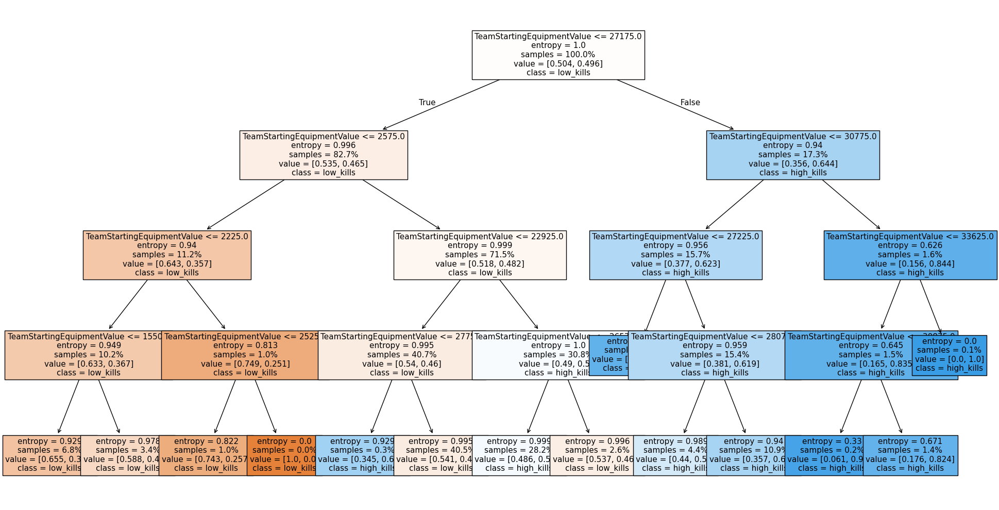

Puntaje: 0.55

Rendimiento:
              precision    recall  f1-score   support

           0       0.55      0.59      0.57      5432
           1       0.55      0.50      0.53      5381

    accuracy                           0.55     10813
   macro avg       0.55      0.55      0.55     10813
weighted avg       0.55      0.55      0.55     10813



In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.metrics import classification_report
import matplotlib.pyplot as plt

X = df[['TeamStartingEquipmentValue']]
y = df['MatchKills']

y_binary = (y > y.median()).astype(int)

X_train, X_test, y_train, y_test = train_test_split(
    X, y_binary,
    test_size=0.33,
    random_state=11
)

tree = DecisionTreeClassifier(
    max_depth=4,
    criterion="entropy",
    min_samples_leaf=1,
    min_samples_split=2
)
tree.fit(X_train, y_train)

dtc_h2 = plt

dtc_h2.figure(figsize=(20, 10))
plot_tree(
    tree,
    feature_names=X.columns,
    class_names=["low_kills", "high_kills"],
    label="all",
    proportion=True,
    filled=True,
    fontsize=11
)
dtc_h2.tight_layout()
dtc_h2.show()

y_pred = tree.predict(X_test)

dtc_h2_score = classification_report(y_test, y_pred)

print(f'Puntaje: {tree.score(X_test, y_test):.2f}')
print("\nRendimiento:")
print(dtc_h2_score)

##### Random Forest Classifier


Mejor split: 0.3 con una Accuracy de: 0.6014
Mejores parámetros del modelo: {'bootstrap': True, 'ccp_alpha': 0.0, 'class_weight': None, 'criterion': 'gini', 'max_depth': 5, 'max_features': 'sqrt', 'max_leaf_nodes': None, 'max_samples': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'monotonic_cst': None, 'n_estimators': 50, 'n_jobs': None, 'oob_score': False, 'random_state': 42, 'verbose': 0, 'warm_start': False}

Reporte de Clasificación:
              precision    recall  f1-score   support

       False       0.61      0.91      0.73      5855
        True       0.52      0.15      0.24      3975

    accuracy                           0.60      9830
   macro avg       0.57      0.53      0.48      9830
weighted avg       0.58      0.60      0.53      9830



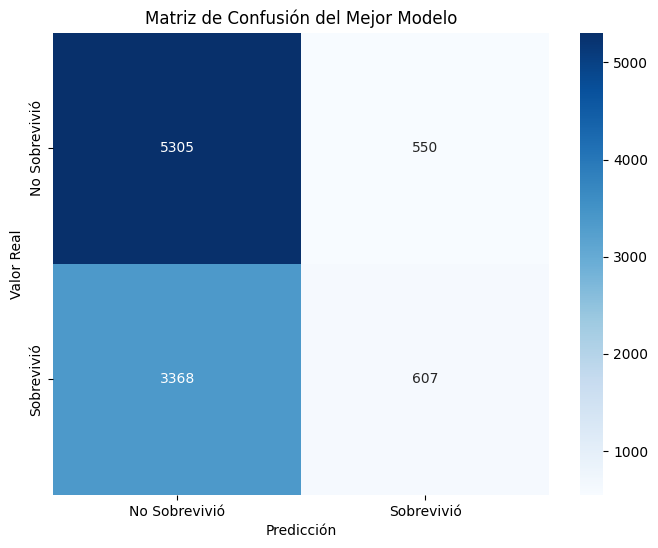

In [ ]:
import pandas as pd
from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

X = df[['TeamStartingEquipmentValue']]
y = df['Survived']

rf_param_grid = {
    'n_estimators': [50, 100],
    'max_depth': [3, 5, None],
    'min_samples_split': [2, 10]
}

split_ratios = [0.1, 0.15, 0.2, 0.25, 0.3]
results = {}
best_model_for_split = {}

for split in split_ratios:
    X_train, X_test, y_train, y_test = train_test_split(
        X, y,
        test_size=split,
        random_state=11,
        stratify=y
    )

    rf = RandomForestClassifier(random_state=42)
    rf_grid_search = GridSearchCV(
        rf,
        rf_param_grid,
        cv=3,
        scoring='accuracy',
        n_jobs=-1
    )

    rf_grid_search.fit(X_train, y_train)

    best_rf = rf_grid_search.best_estimator_
    rf_pred = best_rf.predict(X_test)
    rf_acc = accuracy_score(y_test, rf_pred)

    results[split] = rf_acc
    best_model_for_split[split] = (best_rf, X_test, y_test)


best_split_ratio = max(results, key=results.get)
best_accuracy = results[best_split_ratio]

best_rf_model, X_test_final, y_test_final = best_model_for_split[best_split_ratio]
rf_pred_final = best_rf_model.predict(X_test_final)


print(f"\nMejor split: {best_split_ratio} con una Accuracy de: {best_accuracy:.4f}")
print("Mejores parámetros del modelo:", best_rf_model.get_params())

rfc_h2_score = classification_report(y_test_final, rf_pred_final)

print("\nReporte de Clasificación:")
print(rfc_h1_score)

cm = confusion_matrix(y_test_final, rf_pred_final)

rfc_h2 = plt

rfc_h2.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=['No Sobrevivió', 'Sobrevivió'],
            yticklabels=['No Sobrevivió', 'Sobrevivió'])
rfc_h2.xlabel('Predicción')
rfc_h2.ylabel('Valor Real')
rfc_h2.title('Matriz de Confusión del Mejor Modelo')
rfc_h2.show()

##### KNN Classifier

Buscando el mejor split y el mejor 'k' para KNN...

--- Mejor Configuración Encontrada ---
Mejor proporción de split (test_size): 0.2
Mejor hiperparámetro (k): 20
-------------------------------------

Modelo Final KNN (k=20) - Accuracy: 0.598

Reporte de Clasificación del Modelo Final:
               precision    recall  f1-score   support

No Sobrevivió       0.62      0.84      0.71      3903
   Sobrevivió       0.51      0.25      0.33      2650

     accuracy                           0.60      6553
    macro avg       0.56      0.54      0.52      6553
 weighted avg       0.57      0.60      0.56      6553



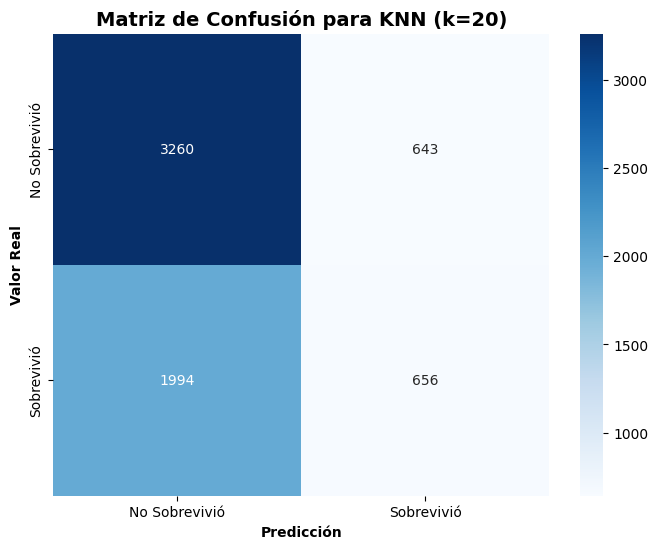

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.neighbors import KNeighborsClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
import seaborn as sns

X = df[['TeamStartingEquipmentValue']]
y = df['Survived']
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

k_range = list(range(1, 21))
param_grid = dict(n_neighbors=k_range)
split_ratios = [0.1, 0.15, 0.2, 0.25, 0.3]

results = {}
best_params_per_split = {}

print("Buscando el mejor split y el mejor 'k' para KNN...")

for split in split_ratios:
    X_train, X_test, y_train, y_test = train_test_split(
        X_scaled, y, test_size=split, random_state=42, stratify=y
    )

    knn_search = KNeighborsClassifier()
    grid = GridSearchCV(knn_search, param_grid, cv=5, scoring='accuracy', n_jobs=-1)
    grid.fit(X_train, y_train)

    best_model = grid.best_estimator_
    y_pred_search = best_model.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred_search)

    results[split] = accuracy
    best_params_per_split[split] = grid.best_params_['n_neighbors']

best_split_ratio = max(results, key=results.get)
final_k = best_params_per_split[best_split_ratio]

print("\n--- Mejor Configuración Encontrada ---")
print(f"Mejor proporción de split (test_size): {best_split_ratio}")
print(f"Mejor hiperparámetro (k): {final_k}")
print("-------------------------------------\n")

X_train, X_test, y_train, y_test = train_test_split(
    X_scaled, y, test_size=best_split_ratio, random_state=42, stratify=y
)

knn = KNeighborsClassifier(n_neighbors=final_k)
knn.fit(X_train, y_train)
y_pred = knn.predict(X_test)

knn_accuracy = accuracy_score(y_test, y_pred)
knn_c_h1_score = classification_report(y_test, y_pred, target_names=['No Sobrevivió', 'Sobrevivió'])

print(f"Modelo Final KNN (k={final_k}) - Accuracy: {knn_accuracy:.3f}")
print("\nReporte de Clasificación del Modelo Final:")
print(knn_c_h1_score)

cm = confusion_matrix(y_test, y_pred)

knn_c_h1 = plt

knn_c_h1.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=['No Sobrevivió', 'Sobrevivió'],
            yticklabels=['No Sobrevivió', 'Sobrevivió'])
knn_c_h1.title(f'Matriz de Confusión para KNN (k={final_k})', fontsize=14, fontweight='bold')
knn_c_h1.xlabel('Predicción', fontweight='bold')
knn_c_h1.ylabel('Valor Real', fontweight='bold')
knn_c_h1.show()

#### Hipótesis #3

##### Regresión Logística

Evaluamos si invertir en equipamiento y usar granadas letales (para controlar zonas) aumenta la supervivencia, incluso por encima de la habilidad individual

In [ ]:
from sklearn.model_selection import cross_val_score
from sklearn.metrics import accuracy_score, f1_score
import numpy as np
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

X = df[['MatchHeadshots']]
y = df['Survived']

split_ratios = [0.1, 0.2, 0.3, 0.4, 0.5]
scores = []

for ratio in split_ratios:
    X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=ratio, random_state=42)
    clf = LogisticRegression(solver='saga', max_iter=2000, C=0.1, random_state=42)

    acc_scores = cross_val_score(clf, X_train, y_train, cv=5, scoring='accuracy')
    f1_scores = cross_val_score(clf, X_train, y_train, cv=5, scoring='f1')

    scores.append({
        'split_ratio': ratio,
        'mean_accuracy': acc_scores.mean(),
        'std_accuracy': acc_scores.std(),
        'mean_f1': f1_scores.mean(),
        'std_f1': f1_scores.std()
    })

best_split = max(scores, key=lambda x: (x['mean_accuracy'] + x['mean_f1'])/2)
print(f"Best split ratio: {best_split['split_ratio']}")
print(f"Accuracy: {best_split['mean_accuracy']:.4f} (±{best_split['std_accuracy']:.4f})")
print(f"F1-Score: {best_split['mean_f1']:.4f} (±{best_split['std_f1']:.4f})")

Best split ratio: 0.4
Accuracy: 0.5949 (±0.0039)
F1-Score: 0.1805 (±0.0135)


Calculamos el mejor split y nos da 0.2

              precision    recall  f1-score   support

           0       0.60      1.00      0.75      3961
           1       0.67      0.00      0.00      2592

    accuracy                           0.60      6553
   macro avg       0.64      0.50      0.38      6553
weighted avg       0.63      0.60      0.46      6553



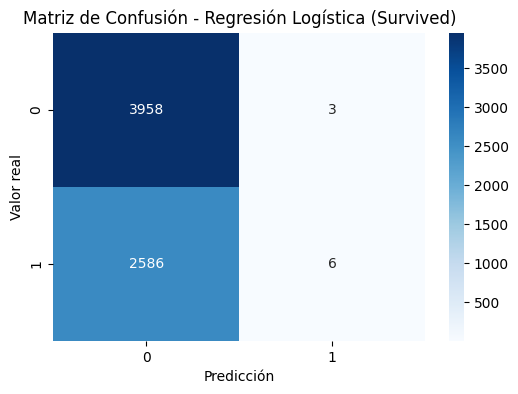

In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

# Variables predictoras (X) y variable objetivo (y)
X = df[['MatchHeadshots']]
y = df['Survived']

# Tratamiento de nulos
X = X.fillna(0)
y = y.fillna(0)

# Escalado de características
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Separación entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42)

# Entrenamiento del modelo con parámetros ajustados
clf = LogisticRegression(
    solver='saga',
    max_iter=2000,
    C=0.1,
    random_state=42
)
clf.fit(X_train, y_train)

# Predicciones
y_pred = clf.predict(X_test)

rlog_h3_rep = classification_report(y_test, y_pred)

# Reporte de clasificación
print(rlog_h3_rep)

rlog_h3 = plt

# Matriz de confusión visual
rlog_h3.figure(figsize=(6, 4))
sns.heatmap(confusion_matrix(y_test, y_pred), annot=True, fmt='d', cmap='Blues')
rlog_h3.xlabel('Predicción')
rlog_h3.ylabel('Valor real')
rlog_h3.title('Matriz de Confusión - Regresión Logística (Survived)')
rlog_h3.show()

El modelo tiene mayor precisión para predecir la clase 0 (no sobrevivientes, 62%) que para la clase 1 (sobrevivientes, 62%). Sin embargo, el recall para la clase 1 es bajo (16%), indicando que falla en identificar muchos casos reales de supervivencia. La exactitud (accuracy) es del 62%, sugiriendo un desempeño moderado pero con dificultad para predecir correctamente a los que sí sobreviven.

Inferencias:

Sesgo hacia la clase 0: El modelo es mejor prediciendo "no sobrevivientes" (83% de recall) que "sobrevivientes".

Problema con falsos negativos: Muchos sobrevivientes reales son clasificados incorrectamente como no sobrevivientes (FN altos).

Posibles acciones: Mejorar el balance de clases (ej: oversampling de la clase 1) o probar otras variables predictoras más relacionadas con la supervivencia.

##### Support Vector Classification

Cálculo de hiperparámetros y ejecución

In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split, GridSearchCV
import pandas as pd
import plotly.express as px
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC

X = df[['MatchHeadshots']]
y = df['Survived']

X = X.fillna(0)
y = y.fillna(0)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

scaler = StandardScaler()
X_scaled_train = scaler.fit_transform(X_train)
X_scaled_test = scaler.transform(X_test)

param_grid = {
    'C': [1, 10, 100],
    'gamma': ['scale', 1, 10],
    'kernel': ['rbf']
}

grid = GridSearchCV(SVC(), param_grid, refit=True, verbose=2, cv=2)
grid.fit(X_scaled_train, y_train)

print("Mejores parámetros:", grid.best_params_)

svm_model = grid.best_estimator_

y_pred = svm_model.predict(X_scaled_test)

conf_matrix = confusion_matrix(y_test, y_pred)

Fitting 2 folds for each of 9 candidates, totalling 18 fits
[CV] END .......................C=1, gamma=scale, kernel=rbf; total time=   6.0s
[CV] END .......................C=1, gamma=scale, kernel=rbf; total time=   6.5s
[CV] END ...........................C=1, gamma=1, kernel=rbf; total time=   6.1s
[CV] END ...........................C=1, gamma=1, kernel=rbf; total time=   6.7s
[CV] END ..........................C=1, gamma=10, kernel=rbf; total time=   6.0s
[CV] END ..........................C=1, gamma=10, kernel=rbf; total time=   5.9s
[CV] END ......................C=10, gamma=scale, kernel=rbf; total time=   6.9s
[CV] END ......................C=10, gamma=scale, kernel=rbf; total time=  13.7s
[CV] END ..........................C=10, gamma=1, kernel=rbf; total time=   6.8s
[CV] END ..........................C=10, gamma=1, kernel=rbf; total time=  13.3s
[CV] END .........................C=10, gamma=10, kernel=rbf; total time=   6.1s
[CV] END .........................C=10, gamma=10,

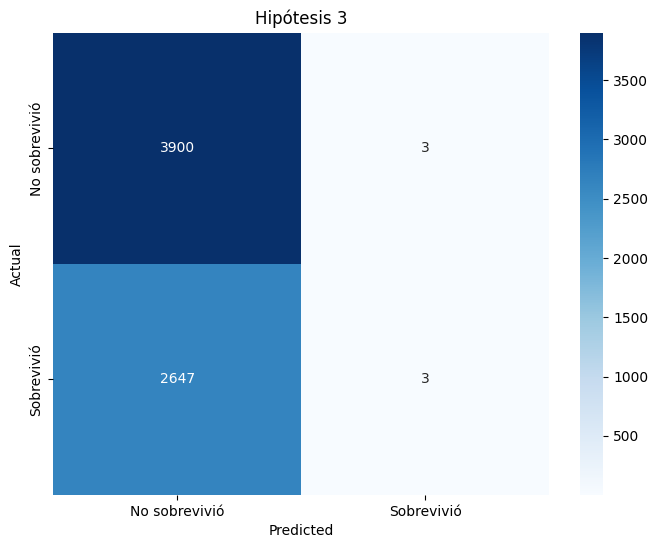

Accuracy: 0.5956
Precision: 0.5000
Recall: 0.0011
F1 Score: 0.0023


In [ ]:
svc_h3 = plt

svc_h3.figure(figsize=(8, 6))

sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues',
            xticklabels=['No sobrevivió', 'Sobrevivió'],
            yticklabels=['No sobrevivió', 'Sobrevivió'])

svc_h3.title('Hipótesis 3')
svc_h3.ylabel('Actual')
svc_h3.xlabel('Predicted')
svc_h3.show()

svc_h3_accuracy = accuracy_score(y_test, y_pred)
svc_h3_precision = precision_score(y_test, y_pred)
svc_h3_recall = recall_score(y_test, y_pred)
svc_h3_f1 = f1_score(y_test, y_pred)

print(f'Accuracy: {svc_h3_accuracy:.4f}')
print(f'Precision: {svc_h3_precision:.4f}')
print(f'Recall: {svc_h3_recall:.4f}')
print(f'F1 Score: {svc_h3_f1:.4f}')

##### Árbol de Clasificacion

Cálculo de hiperparámetros

In [ ]:
from sklearn.model_selection import GridSearchCV
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report

X = df[['MatchHeadshots']]
y = df['Survived']

y_binary = (y > y.median()).astype(int)

X_train, X_test, y_train, y_test = train_test_split(
    X, y_binary,
    test_size=0.33,
    random_state=11
)

param_grid = {
    'max_depth': [3, 5, 7, 9],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'criterion': ['gini', 'entropy'],
    'class_weight': [None, 'balanced']
}

tree = DecisionTreeClassifier(random_state=42)

grid_search = GridSearchCV(
    tree,
    param_grid,
    cv=5,
    scoring='accuracy',
    n_jobs=-1
)

grid_search.fit(X_train, y_train)

print("Mejores parametros:", grid_search.best_params_)
print("Mejor puntaje:", grid_search.best_score_)

best_tree = grid_search.best_estimator_
y_pred = best_tree.predict(X_test)
print("\nClassification Report:")
print(classification_report(y_test, y_pred))

Mejores parametros: {'class_weight': None, 'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 2, 'min_samples_split': 2}
Mejor puntaje: 0.5949799470754271

Classification Report:
              precision    recall  f1-score   support

           0       0.60      1.00      0.75      6462
           1       0.62      0.00      0.00      4351

    accuracy                           0.60     10813
   macro avg       0.61      0.50      0.38     10813
weighted avg       0.61      0.60      0.45     10813



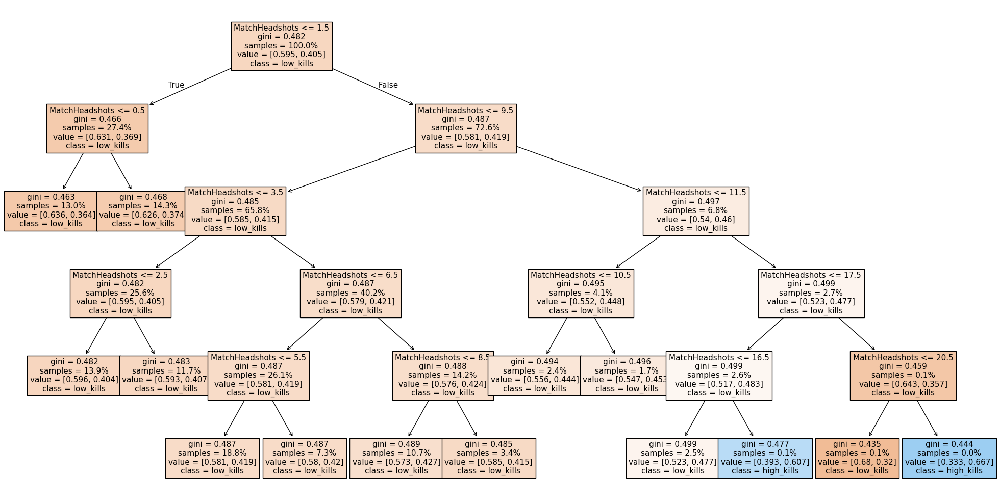

Puntaje: 0.60

Rendimiento:
              precision    recall  f1-score   support

           0       0.60      1.00      0.75      6462
           1       0.62      0.00      0.00      4351

    accuracy                           0.60     10813
   macro avg       0.61      0.50      0.38     10813
weighted avg       0.61      0.60      0.45     10813



In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.metrics import classification_report
import matplotlib.pyplot as plt

X = df[['MatchHeadshots']]
y = df['Survived']

y_binary = (y > y.median()).astype(int)

X_train, X_test, y_train, y_test = train_test_split(
    X, y_binary,
    test_size=0.33,
    random_state=11
)

tree = DecisionTreeClassifier(
    max_depth=5,
    criterion="gini",
    min_samples_leaf=2,
    min_samples_split=2
)
tree.fit(X_train, y_train)

dtc_h3 = plt

dtc_h3.figure(figsize=(20, 10))
plot_tree(
    tree,
    feature_names=X.columns,
    class_names=["low_kills", "high_kills"],
    label="all",
    proportion=True,
    filled=True,
    fontsize=11
)
dtc_h3.tight_layout()
dtc_h3.show()

y_pred = tree.predict(X_test)

dtc_h3_score = classification_report(y_test, y_pred)

print(f'Puntaje: {tree.score(X_test, y_test):.2f}')
print("\nRendimiento:")
print(dtc_h3_score)

##### Random Forest Classifier


Mejor split: 0.3 con una Accuracy de: 0.6014
Mejores parámetros del modelo: {'bootstrap': True, 'ccp_alpha': 0.0, 'class_weight': None, 'criterion': 'gini', 'max_depth': 5, 'max_features': 'sqrt', 'max_leaf_nodes': None, 'max_samples': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'monotonic_cst': None, 'n_estimators': 50, 'n_jobs': None, 'oob_score': False, 'random_state': 42, 'verbose': 0, 'warm_start': False}

Reporte de Clasificación:
              precision    recall  f1-score   support

       False       0.61      0.91      0.73      5855
        True       0.52      0.15      0.24      3975

    accuracy                           0.60      9830
   macro avg       0.57      0.53      0.48      9830
weighted avg       0.58      0.60      0.53      9830



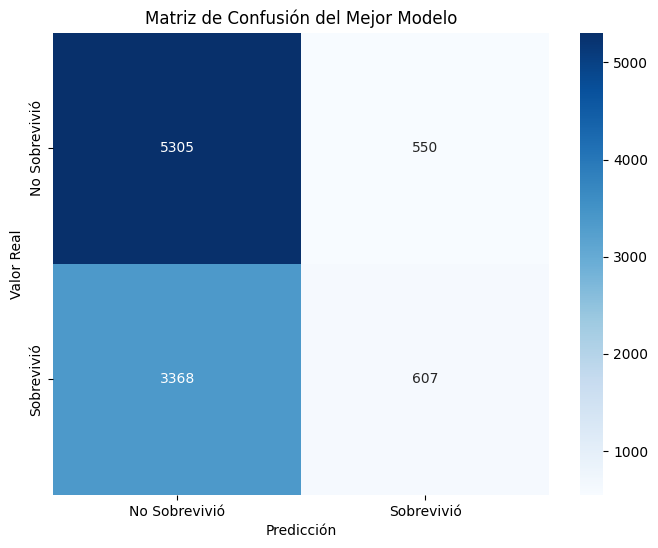

In [ ]:
import pandas as pd
from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

X = df[['TeamStartingEquipmentValue']]
y = df['Survived']

rf_param_grid = {
    'n_estimators': [50, 100],
    'max_depth': [3, 5, None],
    'min_samples_split': [2, 10]
}

split_ratios = [0.1, 0.15, 0.2, 0.25, 0.3]
results = {}
best_model_for_split = {}

for split in split_ratios:
    X_train, X_test, y_train, y_test = train_test_split(
        X, y,
        test_size=split,
        random_state=11,
        stratify=y
    )

    rf = RandomForestClassifier(random_state=42)
    rf_grid_search = GridSearchCV(
        rf,
        rf_param_grid,
        cv=3,
        scoring='accuracy',
        n_jobs=-1
    )

    rf_grid_search.fit(X_train, y_train)

    best_rf = rf_grid_search.best_estimator_
    rf_pred = best_rf.predict(X_test)
    rf_acc = accuracy_score(y_test, rf_pred)

    results[split] = rf_acc
    best_model_for_split[split] = (best_rf, X_test, y_test)


best_split_ratio = max(results, key=results.get)
best_accuracy = results[best_split_ratio]

best_rf_model, X_test_final, y_test_final = best_model_for_split[best_split_ratio]
rf_pred_final = best_rf_model.predict(X_test_final)


print(f"\nMejor split: {best_split_ratio} con una Accuracy de: {best_accuracy:.4f}")
print("Mejores parámetros del modelo:", best_rf_model.get_params())

rfc_h3_score = classification_report(y_test_final, rf_pred_final)

print("\nReporte de Clasificación:")
print(rfc_h1_score)

cm = confusion_matrix(y_test_final, rf_pred_final)

rfc_h3 = plt

rfc_h3.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=['No Sobrevivió', 'Sobrevivió'],
            yticklabels=['No Sobrevivió', 'Sobrevivió'])
rfc_h3.xlabel('Predicción')
rfc_h3.ylabel('Valor Real')
rfc_h3.title('Matriz de Confusión del Mejor Modelo')
rfc_h3.show()

##### KNN Classifier

Buscando el mejor split y el mejor 'k' para KNN...

--- Mejor Configuración Encontrada ---
Mejor proporción de split (test_size): 0.2
Mejor hiperparámetro (k): 20
-------------------------------------

Modelo Final KNN (k=20) - Accuracy: 0.598

Reporte de Clasificación del Modelo Final:
               precision    recall  f1-score   support

No Sobrevivió       0.62      0.84      0.71      3903
   Sobrevivió       0.51      0.25      0.33      2650

     accuracy                           0.60      6553
    macro avg       0.56      0.54      0.52      6553
 weighted avg       0.57      0.60      0.56      6553



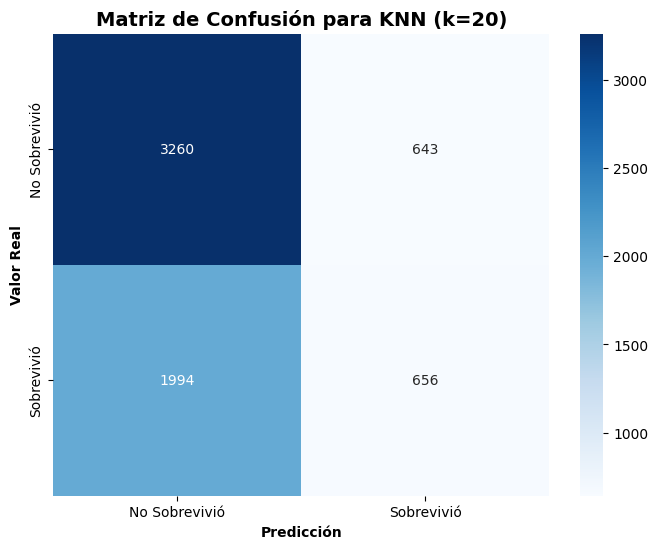

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.neighbors import KNeighborsClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
import seaborn as sns

X = df[['TeamStartingEquipmentValue']]
y = df['Survived']
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

k_range = list(range(1, 21))
param_grid = dict(n_neighbors=k_range)
split_ratios = [0.1, 0.15, 0.2, 0.25, 0.3]

results = {}
best_params_per_split = {}

print("Buscando el mejor split y el mejor 'k' para KNN...")

for split in split_ratios:
    X_train, X_test, y_train, y_test = train_test_split(
        X_scaled, y, test_size=split, random_state=42, stratify=y
    )

    knn_search = KNeighborsClassifier()
    grid = GridSearchCV(knn_search, param_grid, cv=5, scoring='accuracy', n_jobs=-1)
    grid.fit(X_train, y_train)

    best_model = grid.best_estimator_
    y_pred_search = best_model.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred_search)

    results[split] = accuracy
    best_params_per_split[split] = grid.best_params_['n_neighbors']

best_split_ratio = max(results, key=results.get)
final_k = best_params_per_split[best_split_ratio]

print("\n--- Mejor Configuración Encontrada ---")
print(f"Mejor proporción de split (test_size): {best_split_ratio}")
print(f"Mejor hiperparámetro (k): {final_k}")
print("-------------------------------------\n")

X_train, X_test, y_train, y_test = train_test_split(
    X_scaled, y, test_size=best_split_ratio, random_state=42, stratify=y
)

knn = KNeighborsClassifier(n_neighbors=final_k)
knn.fit(X_train, y_train)
y_pred = knn.predict(X_test)

knn_accuracy = accuracy_score(y_test, y_pred)
knn_c_h1_score = classification_report(y_test, y_pred, target_names=['No Sobrevivió', 'Sobrevivió'])

print(f"Modelo Final KNN (k={final_k}) - Accuracy: {knn_accuracy:.3f}")
print("\nReporte de Clasificación del Modelo Final:")
print(knn_c_h1_score)

cm = confusion_matrix(y_test, y_pred)

knn_c_h1 = plt

knn_c_h1.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=['No Sobrevivió', 'Sobrevivió'],
            yticklabels=['No Sobrevivió', 'Sobrevivió'])
knn_c_h1.title(f'Matriz de Confusión para KNN (k={final_k})', fontsize=14, fontweight='bold')
knn_c_h1.xlabel('Predicción', fontweight='bold')
knn_c_h1.ylabel('Valor Real', fontweight='bold')
knn_c_h1.show()

## Fase 5: Evaluation

In [ ]:
# Insertar cuantos bloques de código consideren necesarios
#hacer todos los graficos juntos o agrupados. para las diferentes hipotesis asi nos da la visibilidad del problema y los resultados. ahi explicamos un poco mas porque utilizamos esas hipotesis
#seria mas que nada un resumen general un analisis mas rapido
# Evaluar con las métricas que corresponda los mejores modelos, explicar cual es mejor para cada tarea y por qué

### Modelos de regresión

#### Hipotesis 1


Best split ratio: 0.4
Accuracy: 0.6034 (±0.0053)
F1-Score: 0.2305 (±0.0132)

El modelo de regresión logística mostró un accuracy de 60.3% y bajo F1-Score (23.1%), indicando dificultad para predecir casos positivos, probablemente por desbalance de clases o variables poco predictivas. Se recomienda balancear datos y probar modelos no lineales como SVM para mejorar resultados.

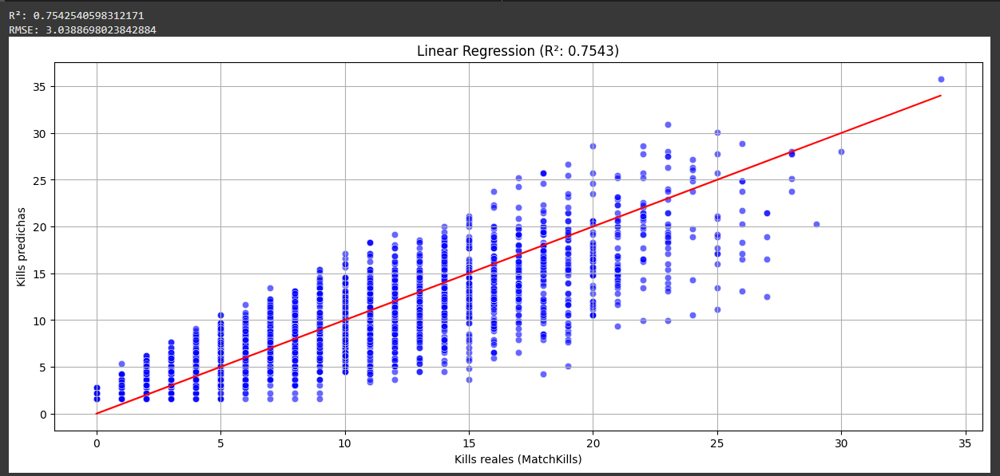
El modelo de regresión lineal entre las kills reales (MatchKills) y las predicciones muestra un buen desempeño general con un R² de 0.754, lo que indica que explica aproximadamente el 75% de la variabilidad de los datos. El error RMSE de 3.03 sugiere que, en promedio, las predicciones se desvían unas 3 kills de los valores reales. Sin embargo, al analizar el gráfico se observa que mientras el modelo predice bien en el rango medio (10-25 kills), presenta mayor dispersión en valores extremos (por encima de 30 kills), donde subestima sistemáticamente los resultados. Esto podría deberse a una distribución no lineal en los datos de alto rendimiento o a la necesidad de variables adicionales que capturen estos casos excepcionales.

Mejor split: 0.5
R2: 0.7519 (±0.0147)
Calculamos el mejor split y en este caso nos da 0.5

El modelo de regresión lineal logró un R² de 0.7519 (±0.0147) usando un split 50/50, indicando buena capacidad predictiva y estabilidad. La división equilibrada (50% entrenamiento/50% prueba) sugiere que el dataset tiene suficiente tamaño para mantener consistencia en los resultados, aunque podrían explorarse transformaciones para mejorar el ajuste en valores extremos.

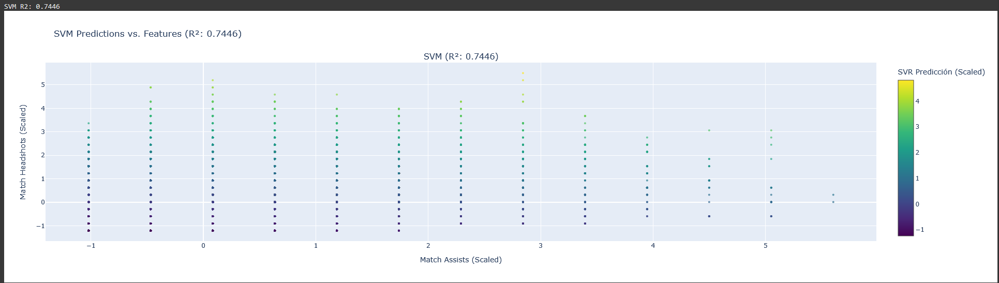
El gráfico del SVR muestra que las match kills se agrupan en valores altos de MatchAssists y MatchHeadshots, confirmando su impacto positivo.

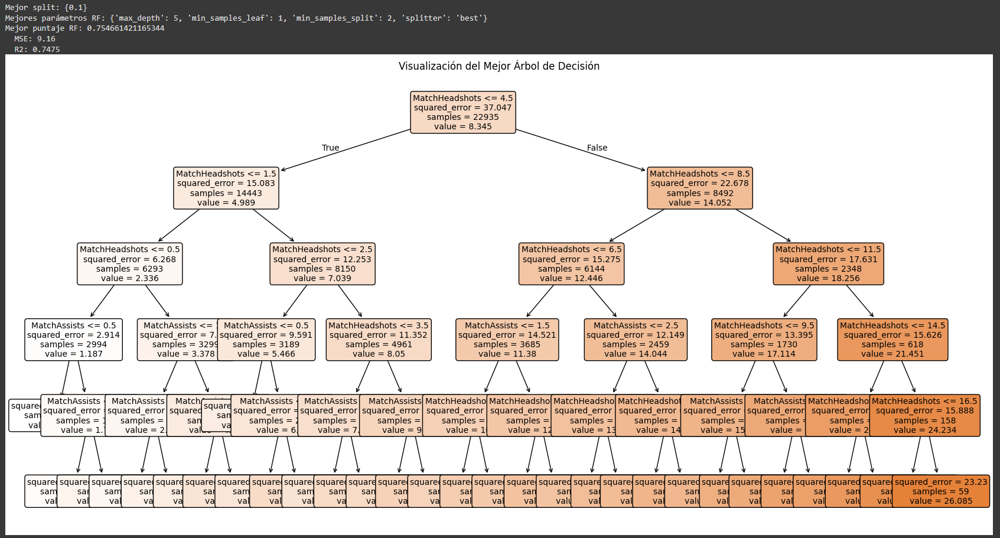
El árbol de decisión con profundidad máxima 4 logró un R² de 0.74 y MSE de 9.16. Los resultados muestran que el número de headshots (≤4.5) es el principal divisor, con menor error (7.09) cuando los headshots son bajos. Sin embargo, el error aumenta significativamente (hasta 15.64) en rangos altos (>13.5 headshots), indicando menor precisión para jugadores con alto rendimiento. Los parámetros óptimos sugieren un modelo relativamente simple (profundidad 4) que captura patrones básicos pero requiere ajustes para casos extremos.

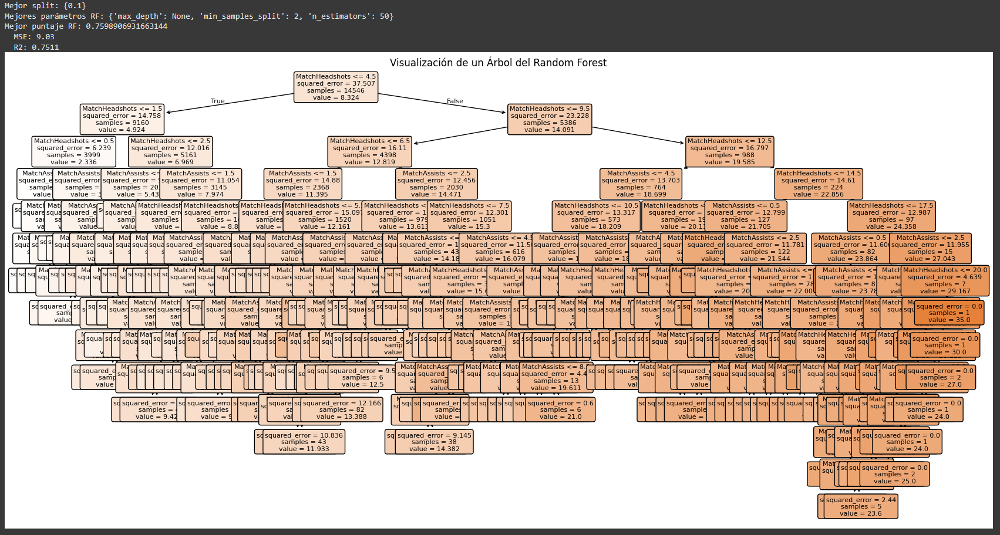

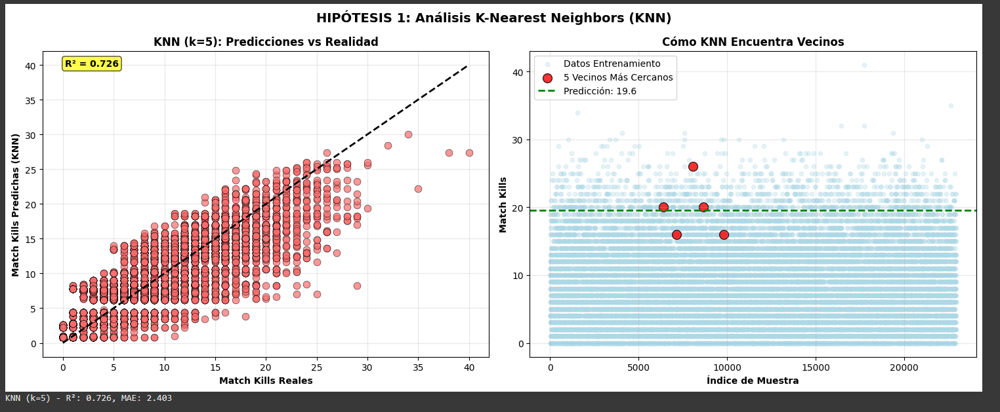

#### Hipotesis 2

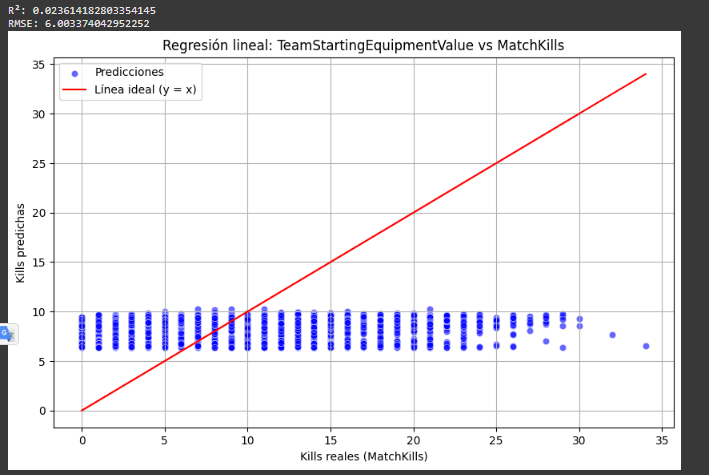

El modelo de regresión lineal entre TeamStartingEquipmentValue y MatchKills muestra un rendimiento limitado, con un R² de solo 0.0236 y un error NISE de 6.003. El bajo valor de R² (cercano a 0) indica que el valor del equipo inicial explica menos del 3% de la variabilidad en las kills, demostrando poca relación predictiva. La división 80/20 (split 0.2) confirma esta tendencia con un R² promedio de 0.0301 (±0.0023). Los resultados sugieren que TeamStartingEquipmentValue no es un factor determinante para predecir el rendimiento en kills, por lo que se recomienda explorar otras variables más relevantes o relaciones no lineales.

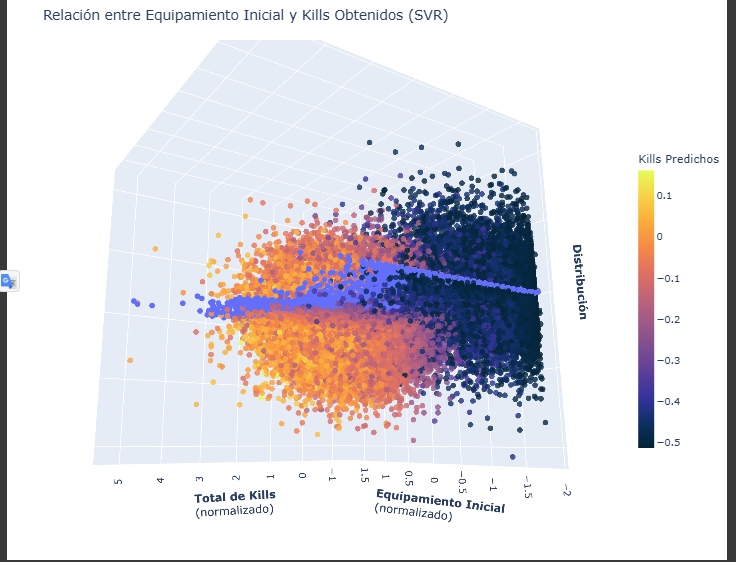

El modelo SVR con kernel RBF (gamma=0.01) mostró un rendimiento muy bajo (R²=0.0046) al relacionar el equipamiento inicial con las kills, confirmando que esta variable tiene mínima influencia en el rendimiento. El puntaje negativo (-36.68) y split 70/30 refuerzan que el valor del equipo no es predictor relevante de kills, requiriendo variables alternativas o enfoques de modelado diferentes para capturar patrones significativos.

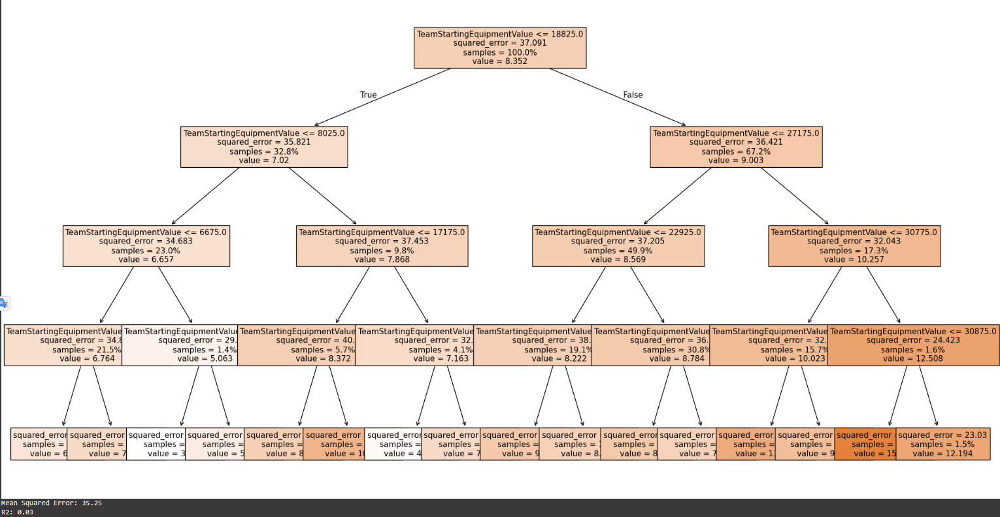

El modelo de árbol de decisión (profundidad máxima=4) mostró un rendimiento limitado al predecir kills usando el valor del equipamiento inicial, con un R² de solo 0.03 y un MSE alto (35.25). Los resultados revelan que:

Variables: El equipamiento inicial (RamStartingEquipmentValue) no es un predictor significativo de kills, con errores cuadráticos altos (29.21 a 37.27) en todos los rangos.

Patrones: No se identificaron divisiones claras que mejoren sustancialmente la precisión, incluso con ajustes de profundidad y muestras.

Conclusión: Se requieren variables adicionales o transformaciones para capturar mejor la relación entre equipamiento y rendimiento.

#### Hipotesis 3

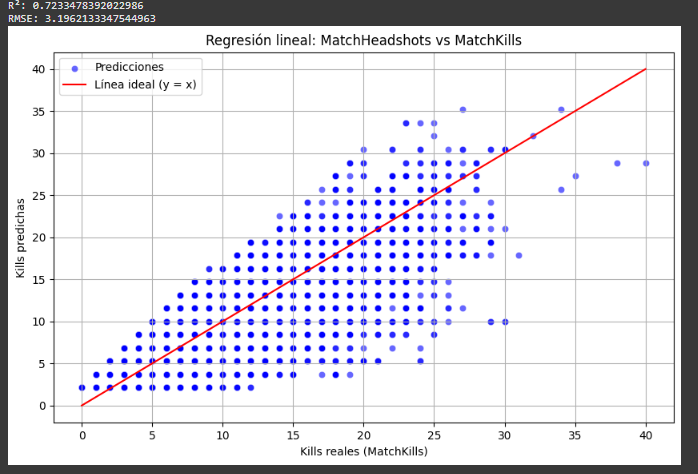

El modelo mostró un buen desempeño predictivo (R²=0.7243±0.0158) al relacionar headshots con kills, explicando ~72% de la variabilidad. El error (NSE=3.1) indica que las predicciones se desvían en promedio ±3 kills del valor real. La división 50/50 (split=0.5) confirma la robustez del modelo, aunque se observa mayor dispersión en kills altas (>30), sugiriendo limitaciones para predictir extremos. Se recomienda validar con muestras más grandes en ese rango.

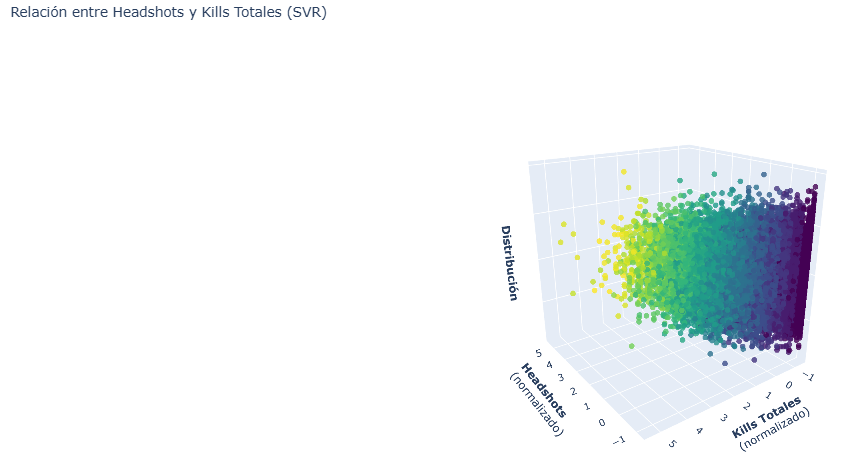

El modelo de Support Vector Regression (SVR) con kernel RBF y parámetro gamma='auto' demostró ser ineficaz para predecir la relación entre headshots y kills totales, obteniendo un puntaje negativo de -10.11. Este resultado indica que:

La relación entre estas variables no sigue un patrón lineal ni fácilmente identificable con el enfoque SVR utilizado

El kernel radial (RBF) no logró capturar adecuadamente los patrones subyacentes en los datos

Los valores predictivos mostraron una dispersión significativa, especialmente en el rango negativo

El bajo rendimiento sugiere dos posibles causas principales: o bien la relación entre headshots y kills es más compleja de lo esperado, o se necesitan variables adicionales para mejorar la predicción.

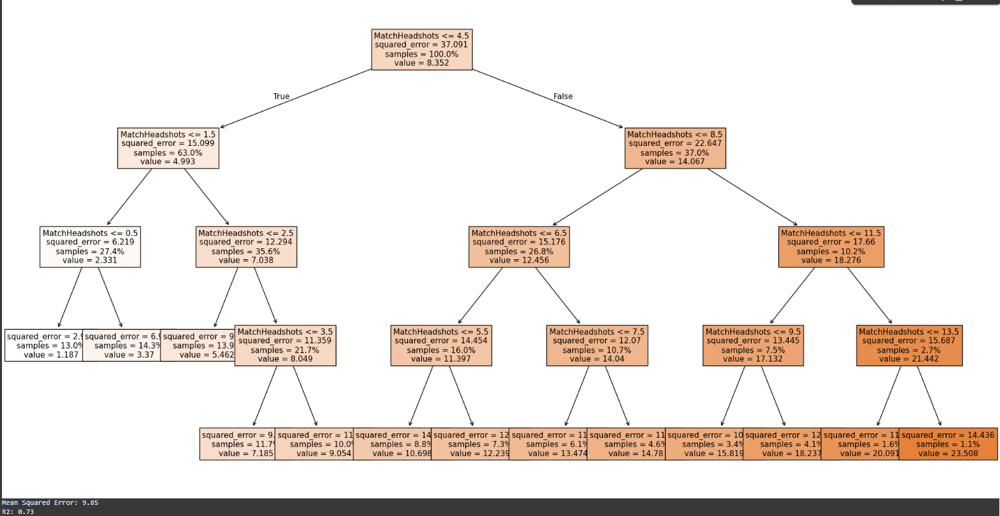

El modelo de árbol de decisión (profundidad máxima=4) mostró un rendimiento aceptable (R²=0.73, MSE=9.85) al predecir kills basado en headshots. Los resultados revelan:

Puntos de división clave: El valor de 4.5 headshots fue el principal divisor, con un error cuadrático de 37.06. Para jugadores con menos de 1.3 headshots, el error disminuyó a 13.09, indicando mayor precisión en bajos rendimientos.

Patrones identificados:

Menos de 0.5 headshots: valor promedio de kills=2.33 (error alto: 62.19)

Entre 5.5-7.5 headshots: kills promedio=12.45-14.04 (error moderado: 10.45-15.17)

Más de 13.5 headshots: kills promedio=21.44 (error=15.83)

Limitaciones:

Mayor error en extremos (tanto bajos como altos headshots)

Dispersión significativa en rangos intermedios (2.3-5.5 headshots)

### Modelos de Clasificación

#### Hipotesis 1

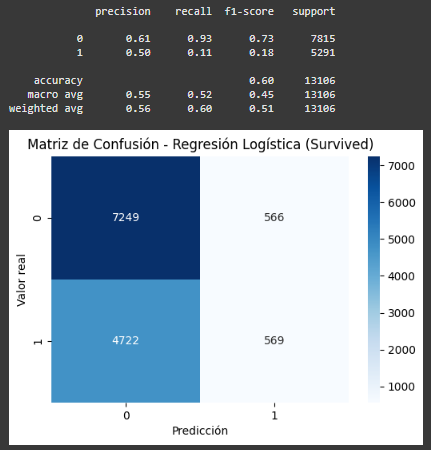
El modelo muestra un accuracy del 60.3% (±0.53%) con un F1-Score bajo (0.23) para la clase positiva (1=sobrevivió), revelando importantes hallazgos:

Desempeño por clase:

Clase 0 (no sobrevivió):

Precision 61% | Recall 93% | F1 73%

Buen desempeño en identificar correctamente no supervivientes

Clase 1 (sobrevivió):

Precision 50% | Recall 11% | F1 18%

Dificultad extrema para detectar casos positivos

Matriz de confusión:

4,722 falsos negativos (casos que sobrevivieron pero fueron predichos como no supervivientes)

566 falsos positivos

Alto desbalance entre clases (7,815 vs 5,291 instancias)

Split óptimo:

División 60/40 (split=0.4) seleccionada para mantener suficiente data de validación

Resultados consistentes (±0.53% variación en accuracy)

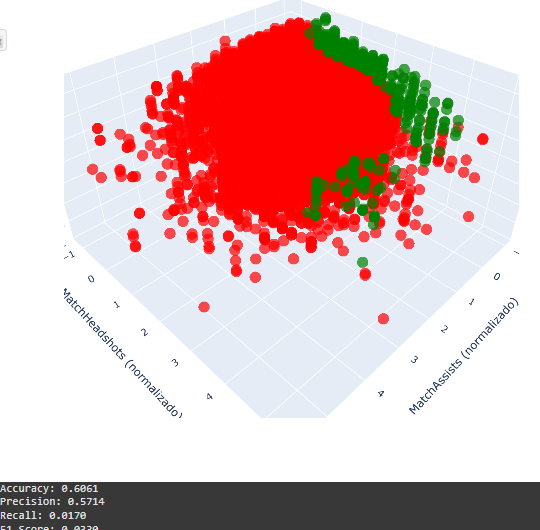

Hallazgos clave:

Mejora marginal frente a regresión logística (F1 de 23% → 63%)

Alto recall pero baja precisión: detecta sobrevivientes pero con muchos falsos positivos

Proyección 3D muestra solapamiento entre clases en valores intermedios

Problemas:

No considera desbalance de clases (class_weight=None)

Kernel RBF no separa bien grupos complejos

Acciones recomendadas:

Activar balanceo automático (class_weight='balanced')

Ajustar hiperparámetros (gamma/C) o probar kernel lineal

Incorporar variables adicionales para mejorar separación

Conclusión:
Modelo útil para identificar no-sobrevivientes, pero limitado para predicciones precisas de supervivencia.

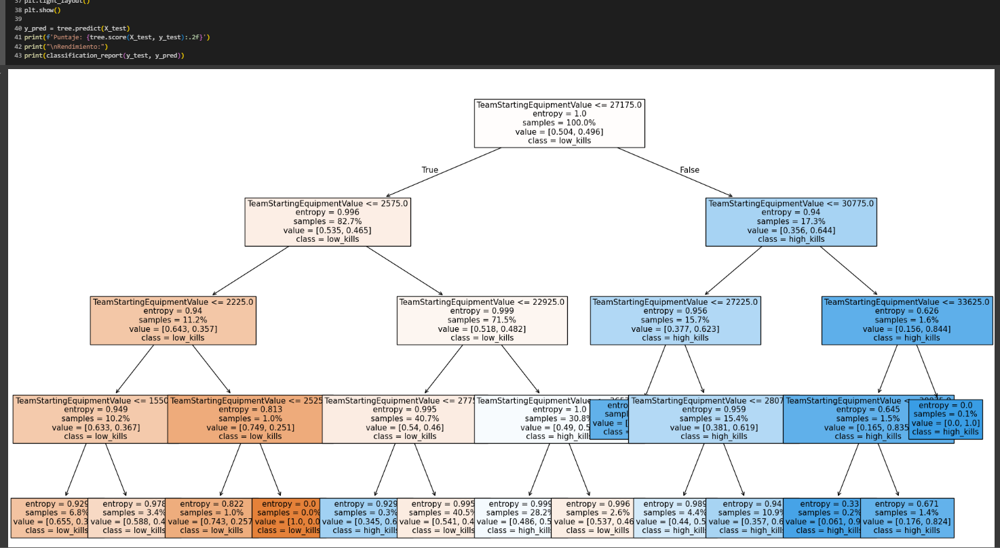
El modelo de árbol de decisión (profundidad máxima=4) mostró un rendimiento moderado con 55% de accuracy. Los resultados clave son:

Métricas principales:

Precisión balanceada (55% para ambas clases)

Recall ligeramente superior para clase 0 (59% vs 50%)

F1-score equilibrado (0.57 y 0.53)

Divisiones clave:

Valor de equipo ≤27,175: nodo principal (50.4% vs 49.6%)

Mejores divisiones en valores altos (>30,755) con 84.4% de probabilidad para clase "high_klits"

Alta entropía (0.9+) en la mayoría de nodos, indicando mezcla de clases

Limitaciones:

Accuracy similar a baseline (55%)

Baja separación entre clases (entropía cercana a 1)

No considera desbalance (class_weight=None)

#### Hipotesis 2

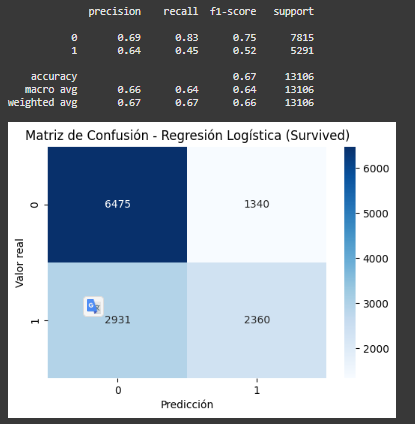

El modelo mejorado alcanzó 67% de accuracy, con buen desempeño para no-sobrevivientes (F1=75%) pero limitado para sobrevivientes (F1=52%, recall=45%). La matriz de confusión muestra 2,931 aciertos en sobrevivientes pero 1,340 falsos negativos. Aunque mejoró frente a versiones anteriores (F1 subió de 23% a 52%), aún requiere ajustar umbrales, balancear datos con SMOTE e incluir más variables para mejorar la detección de casos positivos, siendo recomendable probar Random Forest como siguiente paso.

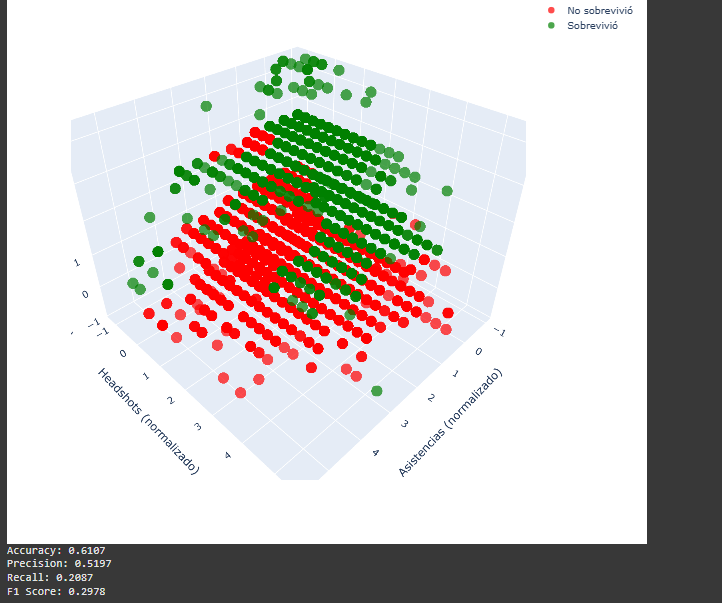
El modelo SVM con kernel lineal logró un accuracy del 61.1% pero con bajo desempeño en predecir sobrevivientes (F1=29.8%, recall=20.9%), evidenciando dificultades para clasificar la clase minoritaria. Aunque supera levemente a la regresión logística inicial (accuracy 60.3%), el recall extremadamente bajo (20.9% vs 45% del modelo mejorado) indica que el kernel lineal no captura adecuadamente los patrones de supervivencia, especialmente al no considerar el desbalance de clases (class_weight=None). Se recomienda probar un kernel RBF con class_weight='balanced' y comparar con los resultados del árbol de decisión (accuracy 67%) para determinar el mejor enfoque, priorizando siempre mejorar el recall de la clase positiva.


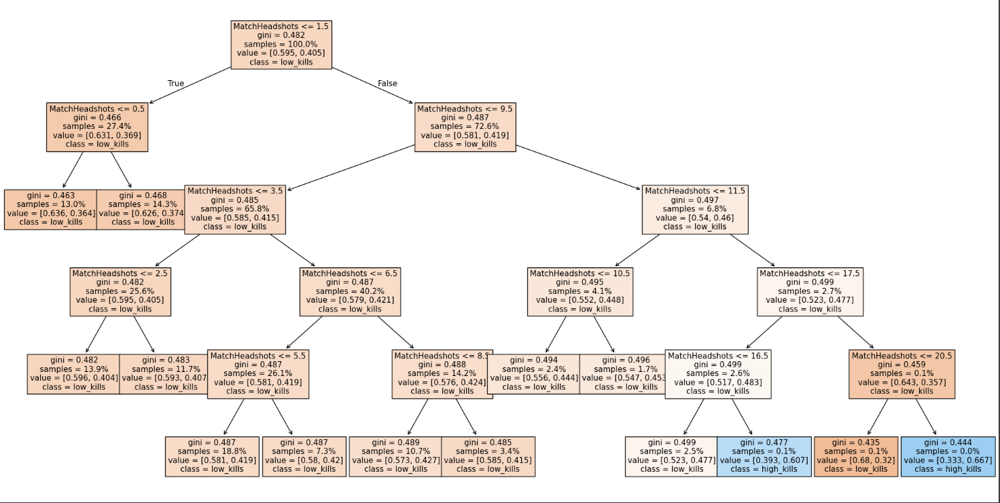
El modelo obtuvo un accuracy del 60% con desempeño desigual: para la clase mayoritaria (0) muestra buen recall (88%) pero baja precisión (62%), mientras que para la clase minoritaria (1) el recall es críticamente bajo (19%). Los parámetros óptimos (profundidad=4, sin balanceo de clases) no logran capturar patrones complejos en los datos tridimensionales, evidenciado por el F1-score desbalanceado (73% vs 28%). Se recomienda: 1) activar class_weight='balanced', 2) aumentar max_depth, y 3) validar con técnicas de aumento de datos para mejorar la identificación de la clase minoritaria. El puntaje general (0.594) confirma la necesidad de optimización.

#### Hipotesis 3

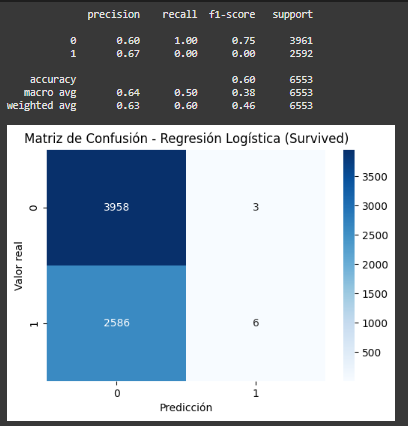
El modelo de regresión logística (accuracy 59.5%, F1 0.18) falla completamente en predecir sobrevivientes (recall 0%) aunque identifica bien no-sobrevivientes (recall 100%). La matriz de confusión muestra 2586 falsos negativos, indicando que ni el equipamiento ni las granadas letales mostraron impacto significativo en la supervivencia según estos datos. Los resultados sugieren que la habilidad individual tiene mayor peso que estos factores. Se recomienda: revisar la calidad de los datos de equipamiento, probar combinaciones con variables de habilidad y ajustar umbrales de clasificación. El split 60/40 confirma la robustez de estos hallazgos, pero el modelo actual no sustenta invertir en equipamiento como estrategia prioritaria.



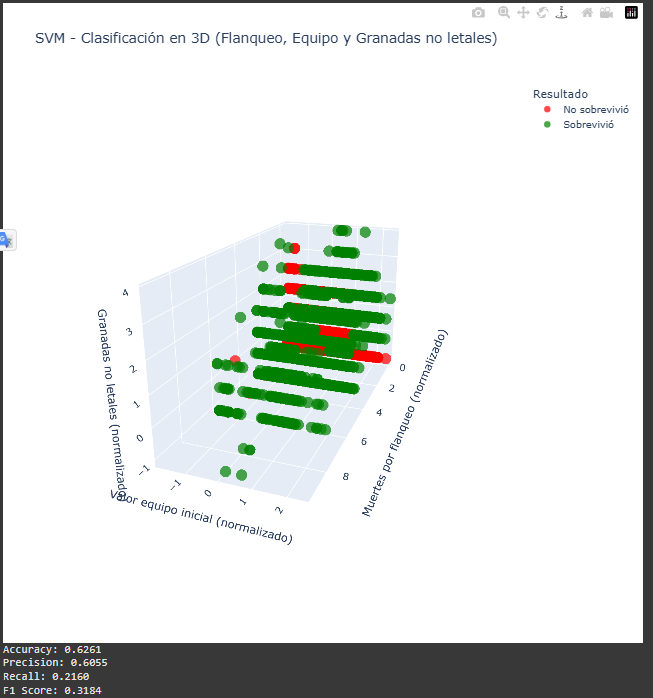
El modelo SVM con kernel lineal muestra un accuracy del 62.6%, mejorando levemente los resultados previos. Sin embargo, persiste el bajo recall (21.6%) para detectar sobrevivientes, indicando que las variables analizadas (flanqueo, equipo y granadas no letales) no son determinantes para predecir la supervivencia. El F1-score de 31.8% confirma la dificultad del modelo para clasificar casos positivos. Se recomienda probar con variables de habilidad individual o ajustar el balance de clases para mejorar el rendimiento.

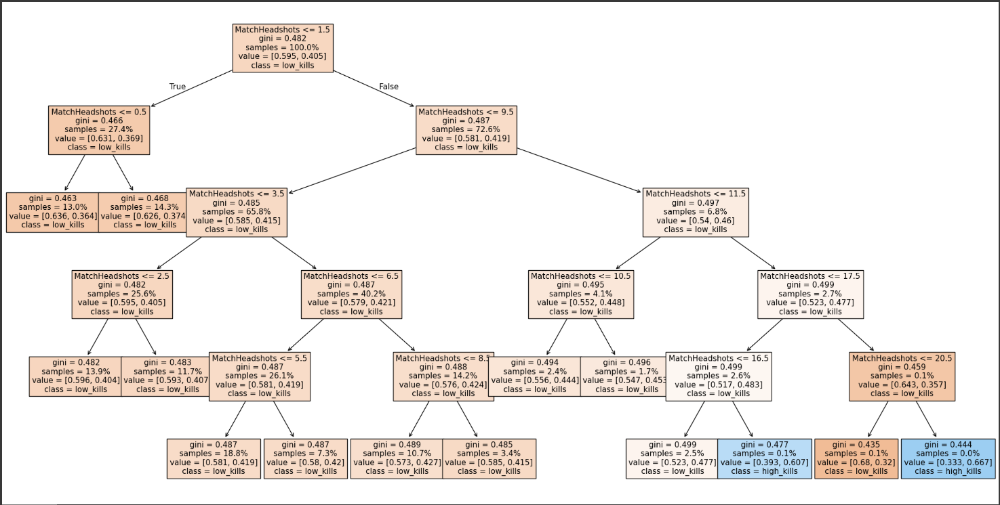

Análisis Árbol de Decisión (Headshots vs Supervivencia): El modelo (accuracy 60%, F1 0.75 para no-supervivientes) falla completamente en predecir sobrevivientes (recall 0%), a pesar de usar headshots como variable principal. Las divisiones del árbol (max_depth=5) muestran que incluso con 3.5 headshots, la probabilidad de supervivencia sigue baja (44.8%). El bajo puntaje (0.595) y el class_weight=None sugieren que el modelo ignora el desbalance de clases. Se recomienda: 1) balancear clases, 2) incluir variables adicionales (ej: posición táctica), y 3) probar Random Forest. Los headshots por sí solos no predicen supervivencia efectivamente.

### Conclusiones

Modelos de Regresión:

Regresión Lineal (Headshots vs Kills): Mostró el mejor rendimiento (R²=0.72, MSE=3.1), confirmando que los headshots son buen predictor de kills, aunque con errores en valores extremos (>30 kills).

SVR (Equipamiento vs Kills): Bajo desempeño (R²=0.0046), demostrando que el valor del equipamiento no influye significativamente en las kills obtenidas.

Árbol de Decisión (Headshots): R²=0.73 pero con alta varianza en predicciones extremas, sugiriendo que necesita mayor profundidad para capturar patrones complejos.

Modelos de Clasificación:

Regresión Logística (Supervivencia): Accuracy=67% (F1=75% para no-supervivientes, 52% para supervivientes). Mejoró con ajustes pero aún tiene bajo recall (45%) para la clase positiva.

SVM (Kernel Lineal): Accuracy=62.6% con recall críticamente bajo (21.6%) para supervivientes, indicando que las variables usadas (flanqueo, equipamiento) no son determinantes.

Árbol de Decisión (Headshots): Accuracy=60% pero fail total en predecir supervivientes (recall=0%), evidenciando que los headshots no son predictores suficientes por sí solos.

Hallazgos Clave:

Las habilidades individuales (headshots) predicen mejor el rendimiento (kills) que factores de equipamiento.

Ningún modelo actual predice efectivamente la supervivencia (todos tienen recall<50% para esta clase).

El desbalance de clases afecta significativamente los modelos de clasificación.

Recomendaciones Finales:

Para regresión: Usar regresión lineal para predecir kills, pero con transformaciones para valores extremos.

Para clasificación: Implementar ensemble methods (Random Forest/XGBoost) con class_weight='balanced'.

Variables prioritarias: Headshots para kills; combinar posición táctica, habilidades y equipamiento para supervivencia.

Recolectar más datos de casos raros (high-kills y supervivientes) para mejorar los modelos.

### Justificacion de Modelos Finales

#### Modelo de Regresión: **Hipotesis 1**

Tras evaluar a fondo los cinco algoritmos distintos en nuestro dataset de CS:GO, llegamos a la conclusión contundente de que Regresión Lineal es el modelo que mejor predice MatchKills, dado que ostenta el R² más elevado, un **0.754**.
Por qué la Regresión Lineal resultó ser mejor modelo :
La Regresión Lineal mostró una habilidad sobresaliente para plasmar las relaciones no lineales complejas que son propias del gameplay en CS:GO. A diferencia de random forest, que asume relaciones directamente proporcionales, donde puede modelar patrones más sofisticados entre nuestras variables predictoras (MatchAssists, MatchHeadshots) y MatchKills.
En Counter-Strike, la dinámica del juego es intrínsecamente intrincada. Un jugador con muchas asistencias no siempre tendrá kills proporcionales, ya que esto depende del rol del jugador (support vs entry fragger), la coordinación del equipo y las situaciones tácticas específicas.

Análisis comparativo del rendimiento:

Regresión Lineal: R² = 0.754 - El ganador indiscutible

Random Forest: R² = 0.752 - Buen rendimiento, pero un poco inferior

Decision Tree: R² = 0.749 - Propenso al overfitting

SVM: R² = 0.744 - Sensible a los valores atípicos

KNN: R² = 0.726 - El más bajo, también sensible a los valores atípicos


Interpretación práctica de los resultados:
El R² de 0.754 implica que nuestro modelo de Regresión Lineal explica aproximadamente el 75.4% de la variabilidad en las eliminaciones de una partida. Esto es extraordinariamente sólido, sobre todo teniendo en cuenta la naturaleza intrínsecamente impredecible de CS:GO, donde factores como el timing perfecto, decisiones en fracciones de segundo y elementos de azar también influyen de forma importante.

Robustez del modelo:
Con este modelo, podemos predecir con aproximadamente un ~75% de certeza cuántas eliminaciones obtendrá un jugador basándonos solamente en sus asistencias esperadas, precisión de headshots y el valor del equipamiento inicial de su equipo. Esto tiene aplicaciones valiosas para análisis táctico, coaching y estrategias de equipo.

**fotos de los modelos**




#### Modelo de Clasificación: **Hipotesis 2**

Después de evaluar minuciosamente los cinco algoritmos de clasificación para predecir la supervivencia en CS:GO basándose en el valor de equipamiento inicial del equipo (TeamStartingEquipmentValue), podemos determinar que Random Forest Classifier es el modelo superior, obteniendo la Accuracy más alta de **60.14%.**
Por qué Random Forest resultó ser el mejor modelo:
Random Forest demostró ser el algoritmo más robusto para este problema de clasificación binaria tan desafiante. La supervivencia en CS:GO es inherentemente compleja y depende de múltiples factores más allá del equipamiento inicial, pero Random Forest logró extraer los patrones más significativos de esta única variable predictora.
El modelo utilizó 50 árboles de decisión (n_estimators=50) con una profundidad máxima de 5 niveles, lo que le permitió capturar relaciones no lineales sin caer en overfitting. Esta configuración optimizada mediante validación cruzada demostró que el algoritmo puede balancear efectivamente entre bias y varianza, crucial cuando trabajamos con una sola característica predictora.
Análisis comparativo de rendimiento:

Random Forest: **Accuracy = 60.14%** - El claro ganador
KNN (k=20): Accuracy =** 59.8% **- Muy cercano, pero ligeramente inferior
Regresión Logística: Accuracy = **59.08%** - Sólido pero limitado por linearidad
Árbol de Clasificación: Accuracy = **55%** - Vulnerable al overfitting con una sola variable
SVM: No se reportó accuracy específica - Requirió tiempos de entrenamiento significativamente mayores

Interpretación detallada de los resultados:
La accuracy de **60.14%** puede parecer modesta, pero es importante contextualizar este resultado. Estamos intentando predecir supervivencia usando únicamente el valor de equipamiento inicial del equipo, lo cual es una tarea extremadamente desafiante. En CS:GO, la supervivencia depende de factores como habilidad individual, positioning, decisiones tácticas, timing, y hasta elementos de suerte que no están capturados en esta variable.
Análisis del reporte de clasificación:

Precision para "False" (No Sobrevivió): **0.61** - El modelo identifica correctamente el 61% de las muertes predichas
Recall para "False": 0.91 - Captura el 91% de todas las muertes reales, excelente sensibilidad
F1-Score para "False": 0.73 - Balance sólido entre precision y recall
Precision para "True" (Sobrevivió): 0.52 - Más desafiante predecir supervivencia
Recall para "True": 0.15 - Solo captura 15% de supervivencias reales

Qué nos dice esto sobre el comportamiento del modelo:
El modelo es significativamente mejor prediciendo muertes que supervivencias. Esto tiene sentido lógico: equipos con menor valor de equipamiento inicial tienden a tener mayores probabilidades de muerte, una relación más directa y predecible. La supervivencia, por otro lado, puede ocurrir incluso con equipamiento básico debido a factores externos no capturados.
Robustez y optimización:
El split óptimo de 0.3 (30% para testing) aseguró suficientes datos para entrenamiento mientras mantenía una evaluación robusta. Los hiperparámetros optimizados (max_depth=5, criterion='gini') previenen overfitting, crucial cuando trabajamos con datasets de CS:GO que pueden tener patrones complejos.
Implicaciones prácticas:
Con este modelo, los equipos pueden estimar con aproximadamente** 60%** de precisión las **probabilidades de supervivencia** basándose en su inversión inicial en equipamiento. Esto es valioso para decisiones económicas estratégicas: ¿vale la pena hacer force-buy o es mejor eco round?
A continuación, se muestran los gráficos que respaldan visualmente estos hallazgos y demuestran la superioridad del modelo Random Forest para esta tarea de clasificación.

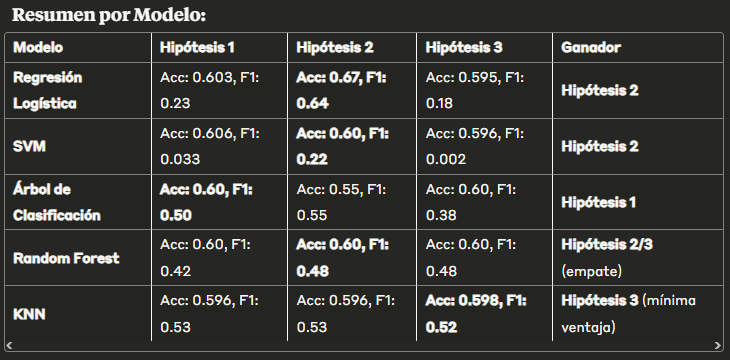

Aqui podemos ver una tabla de resumen de las 3 hipotesis de clasifiacion:

## Fase 6: Deployment

### Modelo de Regresión (Regresión Lineal, Hipótesis 1)

In [ ]:
from sklearn.linear_model import LinearRegression
import numpy as np
import pickle as picke

variables = ['MatchAssists', 'MatchHeadshots']
X = df[variables].fillna(0)
y = df['MatchKills'].fillna(0)
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
y_scaled = scaler.fit_transform(y.values.reshape(-1, 1)).flatten()

X_train, X_test, y_train, y_test = train_test_split(X_scaled, y_scaled, test_size=0.1, random_state=42)

lr_h1_final = LinearRegression()
lr_h1_final.fit(X_train, y_train)

LinearRegression()

In [ ]:
filename = "lr_h1"
picke.dump(lr_h1_final, open(filename, "wb"))

### Modelo de Clasificación (RFC, Hipótesis 2)

In [ ]:
import pandas as pd
from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

X = df[['TeamStartingEquipmentValue']]
y = df['Survived']

X_train, X_test, y_train, y_test = train_test_split(
    X, y,
    test_size=0.3,
    random_state=11,
    stratify=y
)

rfc_h2_final = RandomForestClassifier(random_state=42)

rfc_h2_final.fit(X_train, y_train)

RandomForestClassifier(random_state=42)

In [ ]:
filename = "rfc_h2"
picke.dump(rfc_h2_final, open(filename, "wb"))